> **University of Pisa** \
> **M.Sc Computer Science, Artificial Intelligence** \
> **Data Mining 2022/23** \
> **Authors** \
* Irene Pisani - i.pisani1@studenti.unipi.it - 560104 
* Andrea Iommi - a.iommi2@studenti.unipi.it  - 578212

---
This notebook presents an explorative analysis of the ***users.csv*** and ***tweets.csv*** datasets. In order to know more details about what we have done, we suggest to read te report.

#### Dataset used
1. *users.csv* dataset describes users **general information**.

2. *tweets.csv* reports information about the **single tweet**.

#### Tasks

1. Data Understanding and Preparation
2. **Clustering Analysis**
3. Predictive Analysis (Classification Genuine/Bot)
4. Time series Analysis

In [ ]:
%%capture
!pip3 install pyclustering

In [ ]:
#@title  Libraries 

import math
import numpy as np
import pandas as pd
import collections
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sn

from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_samples
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score

from sklearn.decomposition import PCA

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer

from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import cophenet

import scipy.stats as stats
from scipy.spatial.distance import pdist
from scipy.spatial.distance import squareform

from pyclustering.cluster import cluster_visualizer
from pyclustering.cluster import cluster_visualizer_multidim

from pyclustering.cluster.xmeans import xmeans
from pyclustering.cluster.xmeans import splitting_type
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Task2: Clustering Analysis

In [ ]:
ds = pd.read_csv('/content/drive/MyDrive/DataMining/users2clust.csv', index_col = 0)

## **Pre-processing**

In this project we adopt the common normalizations procedure called **Z-Score**; it exploits the mean and standard deviation of data to center data with respect to these two statistical properties.

In [ ]:
# dataset of numerical attributes 
ds_num = ds.iloc[:,[*range(4,19)]+[*range(22,30)]]

# normalized dataset with z-score
scaler = StandardScaler()
# dataframe of user with normalized features
users_norm = pd.DataFrame(scaler.fit_transform(ds_num),columns=ds_num.columns,index=ds.index)

##  **DBSCAN Clustering**

We perform the density-based clustering using DBSCAN (Density-Based Spatial Clustering of Applications with Noise) algorithm.

DBSCAN is a method based on density, since it connects high density regions, this algorithm is very used from data scientist because it has the advantages to find a non globular shape.  DBSCAN estimates the density around each point by counting the number of points in a **ε**(epsilon) circle specified by parameter and applies thresholds called **minPts** (minimum points) to identify **core**, **border** and **noise** points.
In a second step, the central points are grouped into a cluster, if they are "reachable by density". Finally, onboard points are assigned to clusters. The algorithm only requires eps and minPts parameters.

*We use the DBSCAN also to remove the outliers, in order to have better result in K-means clustering*

### Model selection

To understand which is the optimal assignment for both parameters, we had to try several executions, exploring different combinations of values based on **grid search**. However, there are some heustic methods to identify more or less the range of number for *eps* and *minpts*.

1.   **Epsilon**: we use the **Knee method** to have a idea of which is range of eps.
2.   **MinPts**: We start from |D| + 1 where D is a dimension of dataset



#### Knee method

The method consists of computing the k-nearest neighbor distances in a matrix of points. These k-distances are plotted in an ascending order. The aim is to **determine** the **“knee”**, which corresponds to the optimal eps parameter. *A knee corresponds to a threshold where a sharp change occurs along the k-distance curve.*

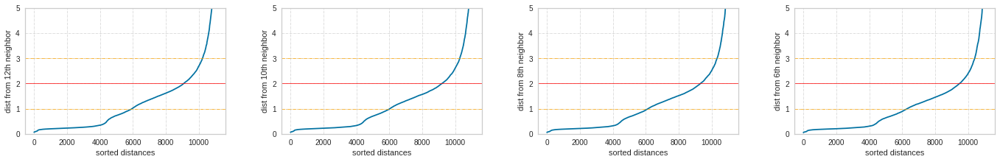

In [ ]:
# Distance matrix
dist = squareform(pdist(users_norm, 'euclidean'))

f, axs = plt.subplots(nrows = 1, ncols = 4, figsize=(20,4))
f.tight_layout(pad=4)
k = 12

for i in range(4):
  kth_distances = [d[np.argsort(d)[k]] for d in dist]

  axs[i].plot(range(0, len(kth_distances)), sorted(kth_distances))
  axs[i].axhline(y=3, color='orange', linestyle='-.',linewidth = 0.7)
  axs[i].axhline(y=2, color='red', linestyle='-',linewidth = 0.7)
  axs[i].axhline(y=1, color='orange', linestyle='-.',linewidth = 0.7)
  axs[i].set_ylim([0,5])
  axs[i].set_ylabel('dist from %sth neighbor' % k)
  axs[i].set_xlabel('sorted distances')
  axs[i].tick_params(axis='both', which='major')
  axs[i].grid(b = True, color ='grey',linestyle ='-.', linewidth = 0.5,alpha = 0.5)  

  k-=2
plt.show()

As we can see, the best *eps* for this dataset is around 2, so we search from **1** to **3**

#### Parameters

In [ ]:
eps_values = [round(eps,3) for eps in np.arange(1 , 3, 0.1)]
min_samples_values = range(10, 30, 2)
print("Number of configuration to try: ",len(eps_values)*len(min_samples_values))

Number of configuration to try:  200


#### Implementation of grid search

In [ ]:
#@title  GridSearch  

class GridSearch:
  def __init__(self,dataset, list_eps: list, list_k: list):

    self.list_eps = list_eps # List of epsilon to try
    self.list_k = list_k # List of minPts to try
    self.dataset = dataset # scaled dataframe
    
    # Dataframe used to store the number of cluster found.
    self.results_clusters = pd.DataFrame( 
        data = np.zeros((len(self.list_eps),len(self.list_k))), # Empty dataframe
        columns = self.list_k, index = self.list_eps)

    # We store each configuration in order to retrieve it after a model selection
    self.results = {}

  def get_metrics(self,index:int, eps: float, minPts:int):
    """
    Give a parameters like esp and minPnt returns the result of DBSCAN 
    """
    # Apply a DBSCAN using a given configuration
    dbscan_model_ = DBSCAN(eps = eps, min_samples = minPts).fit(self.dataset) 
    
    # Saving the configuration on the list
    self.results[index] = dbscan_model_
    
    # Number of point for each cluster (including the noise one)
    points = [len(dbscan_model_.labels_[dbscan_model_.labels_ == i]) for i in range(-1,7,1)]

    # Total number of cluster
    number_of_clusters = len(set(dbscan_model_.labels_))

    return(number_of_clusters, points)  

  def fit(self,verbose:bool=False):
    
    itr = 1 # Count to iteration

    if verbose:
      print("ITER| INFO%s | CLUS NOISE ClS1 ClS2 ClS3 ClS4 ClS5 ClS6 ClS7" % (" "*29))
      print("-"*65)

    for eps in self.list_eps:
        for min_samples in self.list_k:

          # Metric calculation
          cluster_metric, points = self.get_metrics(itr, eps, min_samples)

          if verbose:
            print("%3d | Tested with eps = %3s and k = %3s | %4s %4s %4s %4s %4s %4s %4s %4s %4s" %\
                  (itr, eps, min_samples, cluster_metric, points[0], points[1], points[2], points[3], points[4], points[5], points[6],points[7]))
            
          # Put result on dataframe
          self.results_clusters.loc[eps, min_samples] = cluster_metric

          itr += 1
    
  def showHeatMap(self):
    fig, ax = plt.subplots(figsize=(8,8))
    sn.heatmap(self.results_clusters, annot = True, ax = ax, cbar = False).set_title("METRIC: Number of clusters")
    ax.set_xlabel("Min point")
    ax.set_ylabel("Eps")
    plt.tight_layout();
    plt.show()  
   

In [ ]:
# We apply the Grid search with the first couple of parameters
gs = GridSearch(users_norm, eps_values, min_samples_values)
gs.fit() #verbose = True , to see all combination result

#### Evaluate the best results


We found that the best solution is **eps** = 1.7 and **minPts** = 12, and we obtained **3 clusters + 1 Noise cluster**. Line 72 on the grid search.

**For better understanding we use the no standardized values and we do not show the noise cluster**

In [ ]:
# 72 | Tested with eps = 1.7 and k =  12 |    4 1842 8755   88  378    0    0    0    0

#best_dbscan_label = gs.results[72].labels_
best_dbscan_label = gs.results[1].labels_
users_norm["dbscan_label"], ds["dbscan_label"] = best_dbscan_label, best_dbscan_label

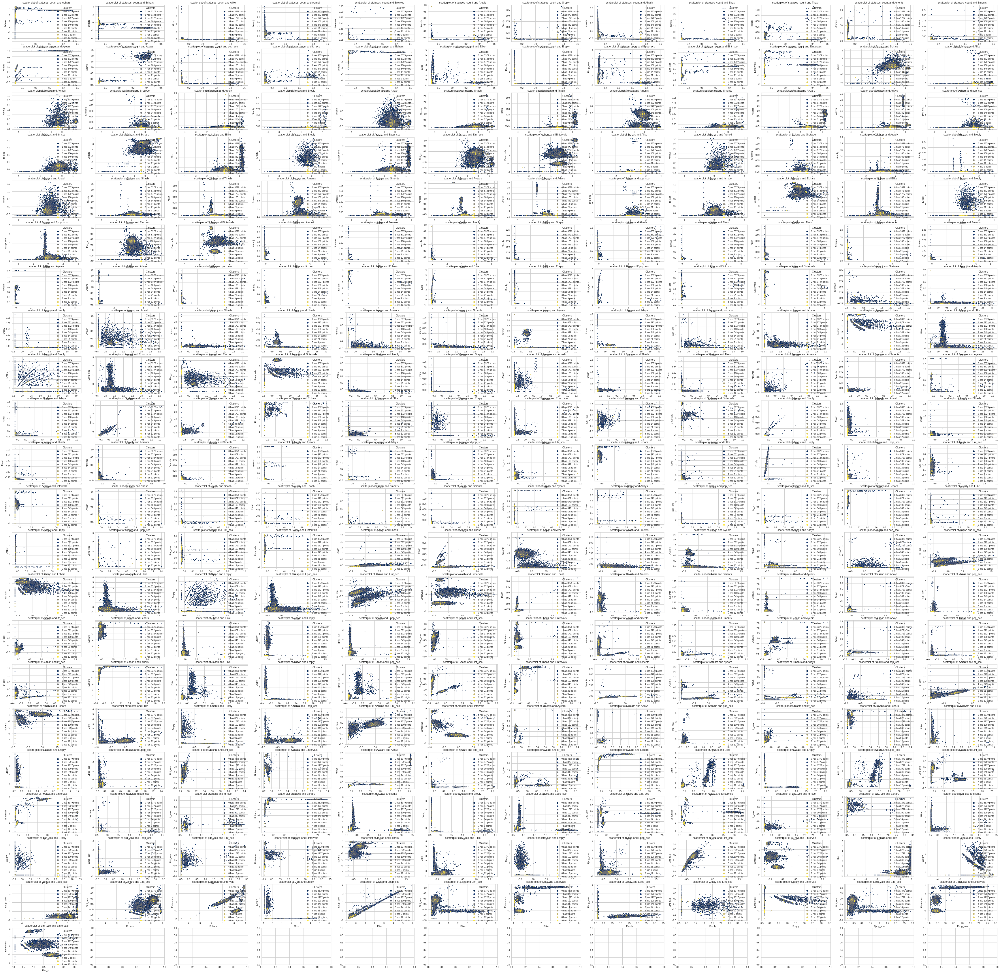

In [ ]:
ncols,idx = 12, 0
n_clust = len(np.unique(best_dbscan_label))
ordered_etiq = users_norm[users_norm.dbscan_label!=-1].sort_values(by="dbscan_label").dbscan_label
dbs_population = ordered_etiq.value_counts(sort=False).values # produce a legend with the unique colors from the scatter
secondlegend = ["{} has {} points".format(j, dbs_population[j]) for j in range(n_clust-1)]

f, axs = plt.subplots(nrows=22, ncols=ncols, figsize=(80,80))
for i, attrA in enumerate(users_norm.columns[:-1]):
    A = users_norm.loc[users_norm.dbscan_label!=-1,attrA]

    for _, attrB in enumerate(users_norm.columns[i+1:-1]):

        B = users_norm.loc[users_norm.dbscan_label!=-1,attrB]
        x,y = int(idx/ncols), idx%ncols
        idx = idx + 1
        sc = axs[x][y].scatter(A, B, c=ordered_etiq,s=10,cmap='cividis')
        axs[x][y].set_title('scatterplot of ' + attrA + ' and ' + attrB)
        axs[x][y].set_xlabel(attrA)
        axs[x][y].set_ylabel(attrB)
        axs[x][y].legend(sc.legend_elements()[0], secondlegend, loc="upper right", title="Clusters")

#### Cluster interpretation

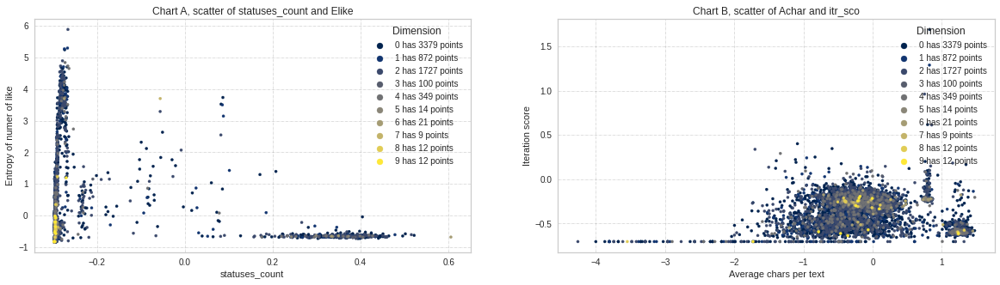

In [ ]:
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,5))

tmp=users_norm[users_norm.dbscan_label!=-1]
axs[0].scatter(tmp["statuses_count"],tmp["Elike"], c=ordered_etiq, s=10, cmap='cividis')
axs[0].set_title("Chart A, scatter of statuses_count and Elike")
axs[0].set_xlabel("statuses_count")
axs[0].set_ylabel("Entropy of numer of like")
axs[0].grid(b = True, color ='grey',linestyle ='-.', linewidth = 0.5,alpha = 0.5)
axs[0].legend(sc.legend_elements()[0], secondlegend, loc="upper right", title="Dimension")
  

axs[1].scatter(tmp["Achars"], tmp["itr_sco"], c=ordered_etiq,s=10,cmap='cividis')
axs[1].set_title("Chart B, scatter of Achar and itr_sco")
axs[1].set_xlabel("Average chars per text")
axs[1].set_ylabel("Iteration score")
axs[1].grid(b = True, color ='grey',linestyle ='-.', linewidth = 0.5,alpha = 0.5)
axs[1].legend(sc.legend_elements()[0], secondlegend, loc="upper right", title="Dimension")

plt.show()

After we chose the best parameters for the DBSCAN, we thought that it was useful to give a interpretation to a given result. We select two chart that seem to be interesting. We omitted the noise cluster in order to have a cleaner vision of other groups.

**Meanings of attributed selected**

Before to go into details of cluster interpretation we need to explain what does means the attributed selected. 

* *statuses_count*: the number of tweets published by the user in total
* *Elike*: (entropy of like) how much are different are the number of likes recieved in all tweets published by user
* *Achars*: Average of number of character for texts
* *itr_score*: (interactivity score) means how much the tweets published have hashtag, urls and mentions in the text

The DBSCAN has recognized a one big cluster and two small ones. In the **cluster 0 and 1** we are not able to identify a particular behaviour because we cannot see a particular "pattern" among all charts generated. Instead, different situation is for **cluster 2** in fact, we observe the behavior is typically associated with a classical user twitter platform.

**Chart A** (on the left):

In the chart A we have a scatterplot of *entropy of number of like* and *statuses_count*. The cluster 2 has a low number of posts published and the entropy of like received covers the range of values. There are some users in the cluster 2 that has a large number of tweets, but are very sparse. We could **associate** the cluster 2 to a group of user that publish **few but relevant** tweets.


**Chart B** (on the right):

In the chart B we have a scatterplot of *Average of chars* and *interactivity score*. Also in this way we can observe that the cluster 2 is concentrated at **60 chars** per tweets and has **low interactivity score**. This situation could be plausible typically for the genuine users:
 1. Does not share a lot of urls,mentions and hashtag.
 2. The length of texts are roughly the same.

#### Evaluation via nature of user

In the chart below it is depicted a barplot of cluster found by DBSCAN, where there is a division between genuine and bot users. 



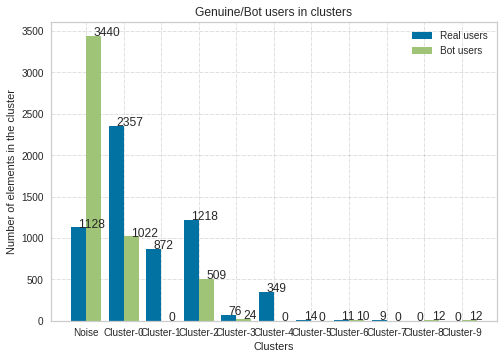

In [ ]:
etiquettes = ["Noise"]+["Cluster-"+ str(i) for i in range(n_clust-1)]
reals = [len(ds[(ds.dbscan_label == i) & (ds.real == True)]) for i in range(-1,n_clust-1,1)]
bots  = [len(ds[(ds.dbscan_label == i) & (ds.real == False)]) for i in range(-1,n_clust-1,1)]
X_axis = np.arange(n_clust)

fig, ax = plt.subplots()
plt.bar(X_axis - 0.2, reals, 0.4, label = 'Real users')
plt.bar(X_axis + 0.2, bots, 0.4, label = 'Bot users')
plt.xticks(X_axis,etiquettes)
plt.title("Genuine/Bot users in clusters")
plt.xlabel("Clusters")
plt.ylabel("Number of elements in the cluster")
plt.legend()
plt.grid(b = True, color ='grey',linestyle ='-.', linewidth = 0.5,alpha = 0.5)  

for p in ax.patches: 
    ax.annotate(np.round(p.get_height(),decimals=2), (p.get_x()+p.get_width()/2, p.get_height()))

plt.show()

The previous interpretation is supported by the genuine/bot chart, in fact, we can notice several things:

1. The **cluster 2** is composed only by **genuine users**, this confirm that we have found a typically behavior of genuine user.

2. In all clusters except of Noise there is a genuine users predominance.

3. The most of **bot users** are grouped into **cluster 0**, which it represents also the greatest. This mix of users and the previous interpretability lead us to say there are not a particular patterns detect. 

#### Evaluation via metrics.
We use Davies bouldi, Silhouette & Calinski Harabasz to give an evaluation of clustering.

In [ ]:
tmp = users_norm.iloc[:,:-1]

m1 = round(davies_bouldin_score(tmp, best_dbscan_label),4)
m2 = round(silhouette_score(tmp, best_dbscan_label),4)
m3 = round(calinski_harabasz_score(tmp, best_dbscan_label),4)

pd.DataFrame([[m1,m2,m3]],index=["Score"],columns=["Davies bouldi","Silhouette","Calinski Harabasz"])

,Davies bouldi,Silhouette,Calinski Harabasz
Score,1.6173,0.1496,300.8062


We have used Davies bouldi, Silhouette and Calinski Harabasz metrics to have a measurable quality of our cluster produced by DBSCAN.

**Davies bouldi score**:

With a value equal to 2.087 confirms the fact that the obtained cluster are not well separated. For the bouldi score lower values indicating better quality of clustering.

**Silhouette**:

The silhouette score (which measure cohesion and separation of the cluster) confirms us that we found a one big and dense cluster (called 1) that has the particularity to assume a low value for all attributes. Instead a noise cluster (called -1) which is more sparse can assume any values inside the region.

**Calinski Harabasz**:

This metrics has the aim to evaluate the dispersion of the data, in fact the high value of metrics and 2D charts allows us to say that the obtained cluster are not well formed and overlapped.

**Overall conclusion**:

After performing the DBSCAN algorithm several times with different configuration we found some configuration that allow us interpret the result, but in our opinion we conclude that the DBSCAN algorithm is **not suitable** e performing on our dataset.

#### **Clusters visualization in 2 dimension**

In this section we use PCA decomposition to visualize the obtained clusters in 2 dimension.

In [ ]:
dbscan_label = users_norm.dbscan_label
users_norm.drop(columns="dbscan_label", inplace= True)

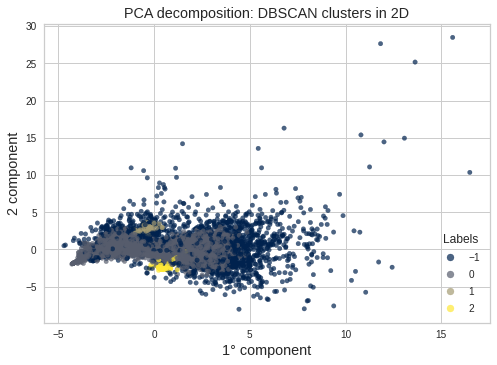

In [ ]:
pca = PCA(n_components=2)

users_norm_pca = pca.fit_transform(users_norm)

sc = plt.scatter(users_norm_pca[:,0], users_norm_pca[:,1], c=dbscan_label, s=20, alpha=0.7, cmap='cividis')
plt.title('PCA decomposition: DBSCAN clusters in 2D', fontdict={'fontsize': 'large'})
plt.xlabel('1° component', fontdict={'fontsize': 'large'})
plt.ylabel('2 component', fontdict={'fontsize': 'large'})

plt.legend(*sc.legend_elements(), #legend_elements creates legend handles and labels for a PathCollection.
                        loc="lower right", title="Labels")

plt.show()

In [ ]:
users_norm['dbscan_label'] = dbscan_label

## **K-Means Clustering**

*Removing the outliers by DBSCAN*

In [ ]:
users_norm = users_norm[users_norm.dbscan_label!=-1].drop("dbscan_label",axis=1)

### **Find Optimal K with clustering evaluation metrics**

### **Optimal K (K = num. of clusters)**

We have looked for the optimal number of clustering by exploiting 3 methods:
1. Elbow/Knee method with distortion error
2. Silhouette method
3. Dendogram method (hierarchical clustering insight) 

We consider different range of k value in order to not discard a priori any suboptimal k value. 

In [ ]:
k_min = 2 # Minimal number of cluster
k_max = [5, 15, 25]
k_candidate = set()

#### **Elbow with distorsion error**

/usr/local/lib/python3.8/dist-packages/yellowbrick/utils/kneed.py:156: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
/usr/local/lib/python3.8/dist-packages/yellowbrick/cluster/elbow.py:374: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)


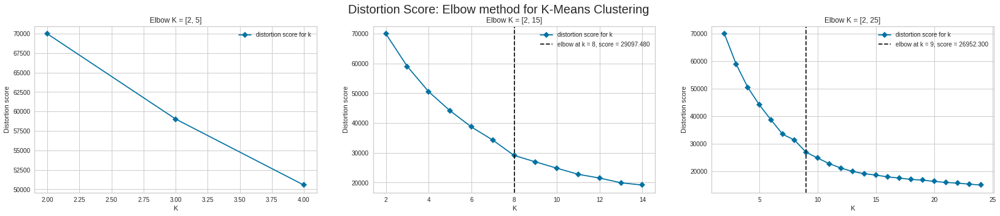

In [ ]:
model = KMeans(init='k-means++', max_iter=100, n_init=10)

f, axs = plt.subplots(ncols=len(k_max), figsize=(28,5))
for idx, k in enumerate(k_max):
    
    vis = KElbowVisualizer(model, k=(k_min,k), metric='distortion', timings=False, ax=axs[idx]).fit(users_norm)
    axs[idx].set_title('Elbow K = [' + str(k_min) + ', ' + str(k) + ']' )
    axs[idx].set_ylabel('Distortion score')
    axs[idx].set_xlabel('K')
    axs[idx].legend(['distortion score for k','elbow at k = ' + str(vis.elbow_value_) + ', score = ' + '{:.3f}'.format(vis.elbow_score_)])

    if vis.elbow_value_ != None:
      k_candidate.add(vis.elbow_value_)
plt.suptitle('Distortion Score: Elbow method for K-Means Clustering',fontsize=20)
plt.show()

#### **Silhouette coefficient**

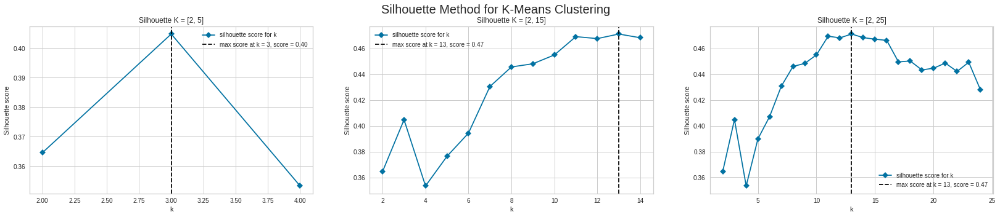

In [ ]:
f, axs = plt.subplots(ncols=len(k_max), figsize=(28,5))
for idx, k in enumerate(k_max):

    vis = KElbowVisualizer(model, k=(k_min,k), metric='silhouette', timings=False, ax=axs[idx], locate_elbow = False).fit(users_norm) 
    
    max_sil_score = max(vis.k_scores_)
    max_sil_index = vis.k_scores_.index(max_sil_score)
    max_sil_k = max_sil_index + k_min

    axs[idx].axvline(x=max_sil_k, linestyle = "--", color="black")
    axs[idx].set_title('Silhouette K = [' + str(k_min) + ', ' + str(k) + ']' )
    axs[idx].set_ylabel('Silhouette score')
    axs[idx].set_xlabel('k')
    axs[idx].legend(['silhouette score for k','max score at k = ' + str(max_sil_k) + ', score = ' + '{:.2f}'.format(max_sil_score)])
    
    if max_sil_k != None:
      k_candidate.add(max_sil_k)

plt.suptitle('Silhouette Method for K-Means Clustering', fontsize=20)
plt.show()

#### **Ward linkage suggestion** (hierarchical clustering)

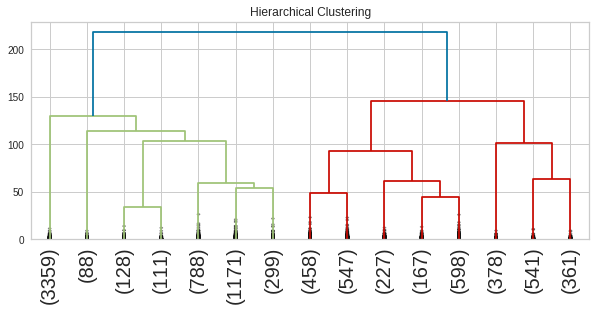

In [ ]:
plt.figure(figsize=(10, 4))
plt.title("Hierarchical Clustering")
dend = dendrogram(linkage(users_norm, method='ward'), 
                  truncate_mode='lastp', p=15, 
                  leaf_rotation=90, 
                  leaf_font_size = 20, 
                  show_contracted=True)

In [ ]:
k_hierarchical = 2
k_candidate.add(k_hierarchical)

In [ ]:
# show all candidate value for k value
k_candidate = np.sort(list(k_candidate))
k_candidate

array([ 2,  3,  8,  9, 13])

Perform K-Means algorithm with all k candidate value and evaluate the obtained cluster with specific metrics to identify the optimal k. 


In [ ]:
evaluation = pd.DataFrame(columns = ["clustering_method", "SSE", 'Davies_Bouldini', 'Silhouette', 'Calinski_Harabasz'])

temp_labels, temp_centers = [], []

for k in k_candidate:

    # for each candidate k value perform clustering with KMeans algorithm
    kmeans = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=100).fit(users_norm)  
    
    # store centroids coordinate
    temp_centers.append(kmeans.cluster_centers_)
    # store computed cluster label
    temp_labels.append(kmeans.labels_)


    # update evaluation dataframe
    new_row = {'clustering_method': 'kmeans - '+str(k),
               'SSE':               kmeans.inertia_, 
               'Davies_Bouldini':   davies_bouldin_score(users_norm,  kmeans.labels_), 
               'Silhouette':        silhouette_score(users_norm,  kmeans.labels_), 
               'Calinski_Harabasz': calinski_harabasz_score(users_norm, kmeans.labels_)}

    evaluation = evaluation.append(new_row, ignore_index=True)

evaluation.set_index(['clustering_method'], inplace=True)

In [ ]:
evaluation

,SSE,Davies_Bouldini,Silhouette,Calinski_Harabasz
clustering_method,,,,
kmeans - 2,69969.311329,1.515535,0.364596,3181.567145
kmeans - 3,59030.091120,1.309141,0.404782,2739.499265
kmeans - 8,29097.497229,1.013227,0.445992,2940.946129
kmeans - 9,26952.299888,1.049880,0.448301,2869.494182
kmeans - 13,19922.963011,1.101262,0.471098,2857.561979


The SSE measures the clusters cohesion and tends to be inversely proportional to the number of clusters indeed an higher value is expected for k = 2. 
The Davies-Bouldini measures the clusters separation (the lower is the score, the higher the cluster will be well-separated). This metrics shows that k-means with k equals to 8 seems to result in the better separated clusters. 
The Silhouette Score takes into account both density and separation among clusters, an higher score relates to a model with better defined clusters and the score for k equals to 13 was the highest among the other candidates.
Also the Calinski-Harabasz score refers to the cluster quality in terms of well-definition,

We decided to take 2 as optimal k value following the highest Calinski-Harabasz score: this choice also allow us to better explore the 2 clusters distributions. 


In [ ]:
evaluation = pd.DataFrame(columns = ["clustering_method", "SSE", 'Davies_Bouldini', 'Silhouette', 'Calinski_Harabasz'])

temp_labels, temp_centers = [], []

for k in k_candidate:

    # for each candidate k value perform clustering with KMeans algorithm
    kmeans = KMeans(n_clusters=k, init='k-means++', n_init=10, max_iter=100).fit(users_norm)  
    
    # store centroids coordinate
    temp_centers.append(kmeans.cluster_centers_)
    # store computed cluster label
    temp_labels.append(kmeans.labels_)


    # update evaluation dataframe
    new_row = {'clustering_method': 'kmeans - '+str(k),
               'SSE':               kmeans.inertia_, 
               'Davies_Bouldini':   davies_bouldin_score(scaler.inverse_transform(users_norm),  kmeans.labels_), 
               'Silhouette':        silhouette_score(scaler.inverse_transform(users_norm),  kmeans.labels_), 
               'Calinski_Harabasz': calinski_harabasz_score(scaler.inverse_transform(users_norm), kmeans.labels_)}

    evaluation = evaluation.append(new_row, ignore_index=True)

evaluation.set_index(['clustering_method'], inplace=True)

In [ ]:
evaluation

,SSE,Davies_Bouldini,Silhouette,Calinski_Harabasz
clustering_method,,,,
kmeans - 2,69969.311329,1.082639,0.517181,3346.787214
kmeans - 3,59030.091120,1.971716,0.494138,2226.636499
kmeans - 8,29097.508758,2.026187,-0.200068,1110.373153
kmeans - 9,26952.299888,2.217900,-0.020028,1104.560171
kmeans - 13,19922.994383,3.679765,-0.008254,1004.055729


since the choice of the optimal value of k based on these 4 metrics was controversial we tried to calculate these scores with respect to the non-normalized dataset: we observed that in this all metrics agreed to choose 2 as the best value of k. This step was useful in giving strength of evidence to the previous choice. 

In [ ]:
# optimal k value is: 2
optimal_k_index = int(0)
k_candidate = list(k_candidate)
k = k_candidate[optimal_k_index] 

centers = temp_centers[optimal_k_index]
kmeans_labels = temp_labels[optimal_k_index]

ds_labels = pd.DataFrame(data={"user_id": ds[ds.dbscan_label!=-1].index,"k-means-2":kmeans_labels})
ds_labels.set_index("user_id", inplace=True)

### **Analysis of the obtained cluster for k= 2**

We are going to study the obtained clusters in order to fully understand the k-means algorithm results using the following strategy for study:

* Cluster population
* Cluster composition with statistic and distribution
* Cluster visualization wrt features space 
* Cluster visualization in 2D (PCA) 
* Centroids analysis: identify most relevant attributes in the clustering process
* Cluster characterization with categorical attribute



#### **Centroids Analysis**

From the analysis of centroids coordinate we can easily assess that the most influential attribute are Ayears and Epop_scr.

In [ ]:
centers

array([[ 0.07824318,  0.32157949, -0.39087906, -0.1042039 , -0.07718443,
         0.09422096, -0.06289541, -0.04796888, -0.08041663, -0.03924762,
         0.10953832,  0.17002227, -0.04583725,  0.68798786,  0.17312944,
         0.26300813,  0.07730577,  0.72672339,  0.75171817, -0.33203568,
         0.71349817,  0.28499557,  1.07232521],
       [-0.29360792, -0.28465075,  0.17320941, -0.01271695, -0.09754838,
        -0.22384607, -0.05992176, -0.06304348, -0.17308871, -0.06605227,
        -0.32178619, -0.37128195, -0.08715538, -0.57275589, -0.32288156,
        -0.32779397, -0.31124553, -0.37625751, -0.48659681,  0.06335681,
        -0.60613815, -0.40692089, -0.59722873]])

<ipython-input-269-b299509c74fd>:22: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  axs[1] = plt.subplot(1,k,j+1,polar=True)


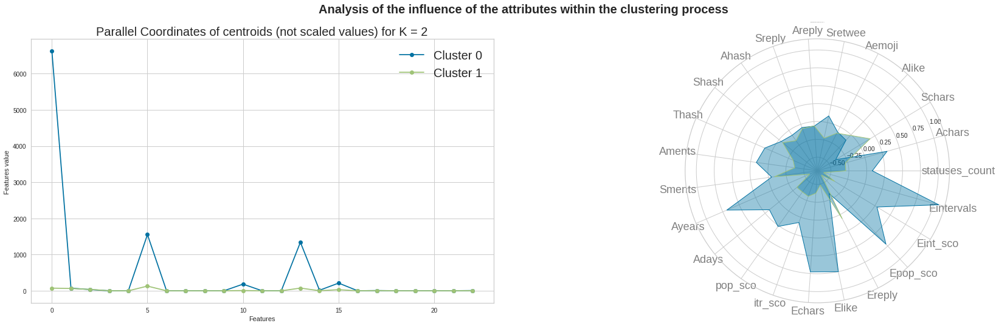

In [ ]:
N = len(ds_num.columns)
center_inv = scaler.inverse_transform(centers)
f, axs = plt.subplots(ncols=2, figsize=(30,8))


for j in range(0, len(centers)):
  axs[0].plot(center_inv[j], marker='o', label='Cluster %s' % j)

axs[0].legend(fontsize=20, loc='upper right')
axs[0].set_xlabel("Features")
axs[0].set_ylabel("Features value ")
axs[0].set_title('Parallel Coordinates of centroids (not scaled values) for K = ' + str(k), fontsize=20)

for i in range(0, len(centers)):
  
  angles = [n / float(N) * 2 * math.pi for n in range(N)]
  values = centers[i].tolist()
  values += values[:1]
  angles += angles[:1]
    
  # Initialise the spider plot
  axs[1] = plt.subplot(1,k,j+1,polar=True)

  # Draw one axe per variable + add labels labels yet
  plt.xticks(angles[:-1], ds_num.columns, color='grey', size=18) 

  # Plot data
  axs[1].plot(angles, values, linewidth=1, linestyle='solid')
 
  # Fill area
  axs[1].fill(angles, values, 'b', alpha=0.4)
  axs[1].set_title('Radar Plots of centroids (normalized values) for K = ' + str(k), fontsize=0)

plt.suptitle(("Analysis of the influence of the attributes within the clustering process\n\n"),fontsize=20, fontweight='bold')

plt.show()

The most influencing variables are: 

In [ ]:
users_norm.columns[0]

'statuses_count'

In [ ]:
users_norm.columns[5]

'Sretwee'

In [ ]:
users_norm.columns[13]

'Ayears'

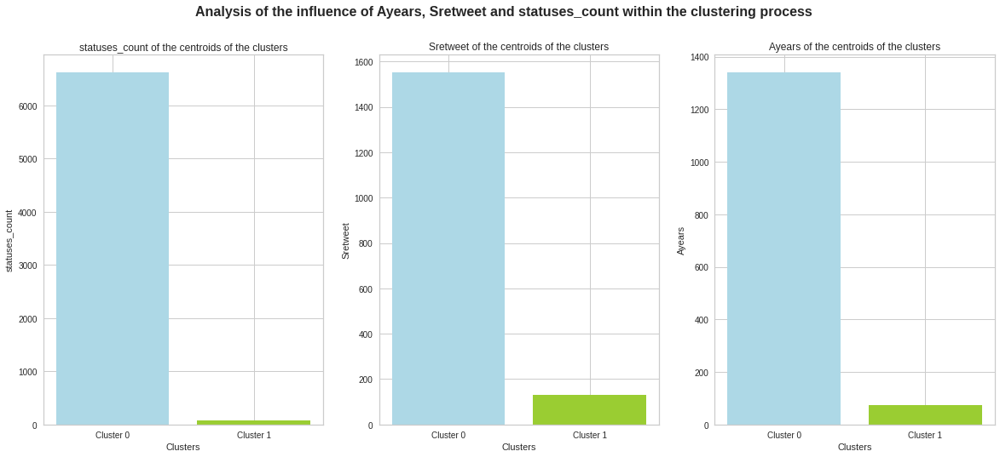

In [ ]:
center_inv = scaler.inverse_transform(centers)

f, axs = plt.subplots(nrows=1, ncols=3, figsize=(20,8))
for i in range(9):
  axs[0].bar(['Cluster 0','Cluster 1'], [center_inv[0][0], center_inv[1][0]], color=['lightblue','yellowgreen'])
  axs[0].set_xlabel('Clusters')
  axs[0].set_ylabel('statuses_count')
  axs[0].set_title('statuses_count of the centroids of the clusters')

  axs[1].bar(['Cluster 0','Cluster 1'], [center_inv[0][5], center_inv[1][5]], color=['lightblue','yellowgreen'])
  axs[1].set_xlabel('Clusters')
  axs[1].set_ylabel('Sretweet')
  axs[1].set_title('Sretweet of the centroids of the clusters')

  axs[2].bar(['Cluster 0','Cluster 1'], [center_inv[0][13], center_inv[1][13]], color=['lightblue','yellowgreen'])
  axs[2].set_xlabel('Clusters')
  axs[2].set_ylabel('Ayears')
  axs[2].set_title('Ayears of the centroids of the clusters')


plt.suptitle(("Analysis of the influence of Ayears, Sretweet and statuses_count within the clustering process"),
              fontsize=16, fontweight='bold')
plt.show()

#### **Cluster composition**

We can observes that one cluster is much bigger and denser than the other one. 
Negative value of silhouette emphasize the presence of possible misclassified points. 

In [ ]:
print(f"number of 0 label: {np.count_nonzero(kmeans_labels)}" )
print(f"number of 1 labels: {kmeans_labels.size - np.count_nonzero(kmeans_labels)}")

number of 0 label: 6088
number of 1 labels: 3133


In [ ]:
data_silhouette = silhouette_samples(users_norm, kmeans_labels)
data_color, data_color_no_outliers = [],[]

for i in range(len(data_silhouette)):
    if data_silhouette[i] < 0:
        data_color.append('r')
    elif kmeans_labels[i] == 0:
        data_color.append('lightblue')
    else:
        data_color.append('yellowgreen')

for i in range(len(data_silhouette)):
    if kmeans_labels[i] == 0:
        data_color_no_outliers.append('lightblue')
    else:
        data_color_no_outliers.append('yellowgreen')

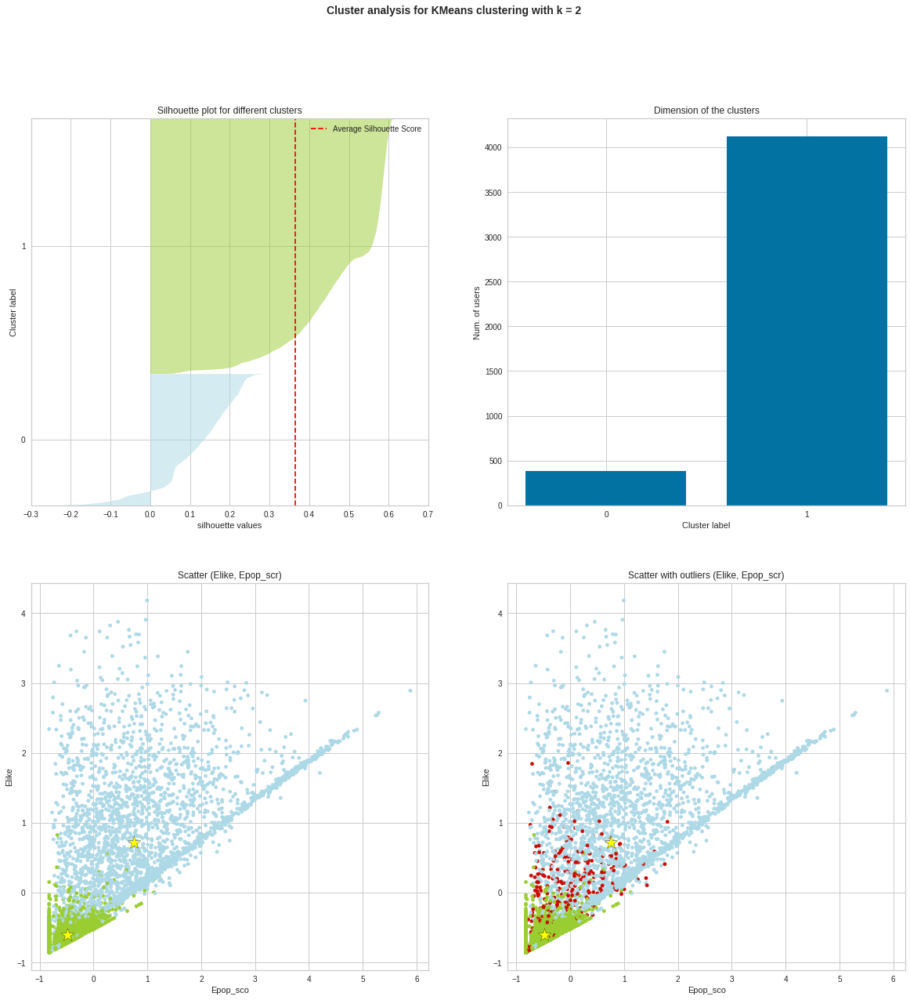

In [ ]:
fig, axs = plt.subplots(nrows=2, ncols=2)
fig.set_size_inches(20, 20)

model = KMeans(k)
vis = SilhouetteVisualizer(model, colors=['lightblue','yellowgreen'], ax = axs[0,0])
vis.fit(users_norm)
vis.finalize()
#vis.poof()

axs[0,0].set_title("Silhouette plot for different clusters")
axs[0,0].set_xlabel("silhouette values")
axs[0,0].set_ylabel("Cluster label")

hist, bins = np.histogram(kmeans.labels_, bins=range(0, len(set(kmeans_labels)) + 1))
axs[0,1].bar(list(set(kmeans_labels)), hist, tick_label=list(set(kmeans_labels)))
axs[0,1].set_title('Dimension of the clusters')
axs[0,1].set_ylabel('Num. of users')
axs[0,1].set_xlabel('Cluster label')


a, b = list(users_norm.columns)[18], list(users_norm.columns)[20]
axs[1,0].scatter(users_norm[a], users_norm[b], c=data_color_no_outliers, s=20)
axs[1,0].set_title('Scatter (Elike, Epop_scr)')
axs[1,0].set_ylabel(str(a))
axs[1,0].set_xlabel(str(b))
axs[1,0].scatter(centers[:,18 ], centers[:, 20], marker="*", c="yellow", alpha=1, s=300, edgecolor='black')


a, b = list(users_norm.columns)[18], list(users_norm.columns)[20]
axs[1,1].scatter(users_norm[a], users_norm[b], c=data_color, s=20)
axs[1,1].set_title('Scatter with outliers (Elike, Epop_scr)')
axs[1,1].set_ylabel(str(a))
axs[1,1].set_xlabel(str(b))
axs[1,1].scatter(centers[:, 18], centers[:, 20], marker="*", c="yellow", alpha=1, s=300, edgecolor='black')


plt.suptitle(("Cluster analysis for KMeans clustering with k = %d" % k), fontsize=14, fontweight='bold')
plt.show()

#### **Visualization of the clustered data wrt different feature spaces**

The following scatter plots emphasize some characteristic of the cluster:
- one cluster (the bigger one) is dense and seems to have a more globular shape
- the other cluster has high degree of sparsity.

In [ ]:
users_norm['kmeans_labels'] = kmeans_labels

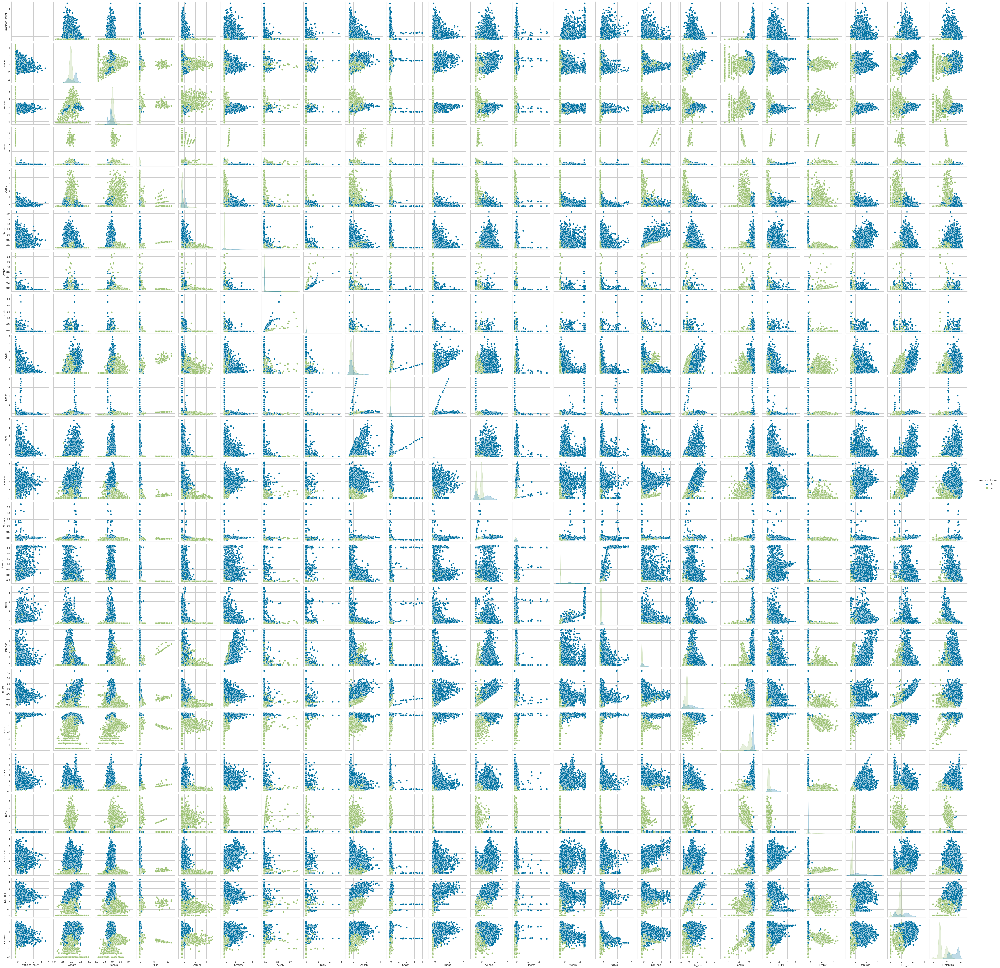

In [ ]:
import seaborn as sns 
sns.pairplot(users_norm, hue="kmeans_labels")

In [ ]:
'''
# alternative pairplot without using seaborn library 

ncols,idx = 12, 0
f, axs = plt.subplots(nrows=13, ncols=ncols, figsize=(70,70))
for i, attrA in enumerate(users_norm.columns):
  A = users_norm[attrA]
  for _, attrB in enumerate(users_norm.columns[i+1:]):
    B = users_norm[attrB]

    x, y, idx = int(idx/ncols), idx%ncols, idx + 1
    axs[x][y].scatter(A, B, c=data_color_no_outliers, s=1)
    axs[x][y].set_title('Scatter( ' + attrA + ' , ' + attrB + ' )')
    axs[x][y].set_xlabel(attrA)
    axs[x][y].set_ylabel(attrB)

plt.show()   

'''

"\n# alternative pairplot without using seaborn library \n\nncols,idx = 12, 0\nf, axs = plt.subplots(nrows=13, ncols=ncols, figsize=(70,70))\nfor i, attrA in enumerate(users_norm.columns):\n  A = users_norm[attrA]\n  for _, attrB in enumerate(users_norm.columns[i+1:]):\n    B = users_norm[attrB]\n\n    x, y, idx = int(idx/ncols), idx%ncols, idx + 1\n    axs[x][y].scatter(A, B, c=data_color_no_outliers, s=1)\n    axs[x][y].set_title('Scatter( ' + attrA + ' , ' + attrB + ' )')\n    axs[x][y].set_xlabel(attrA)\n    axs[x][y].set_ylabel(attrB)\n\nplt.show()   \n\n"

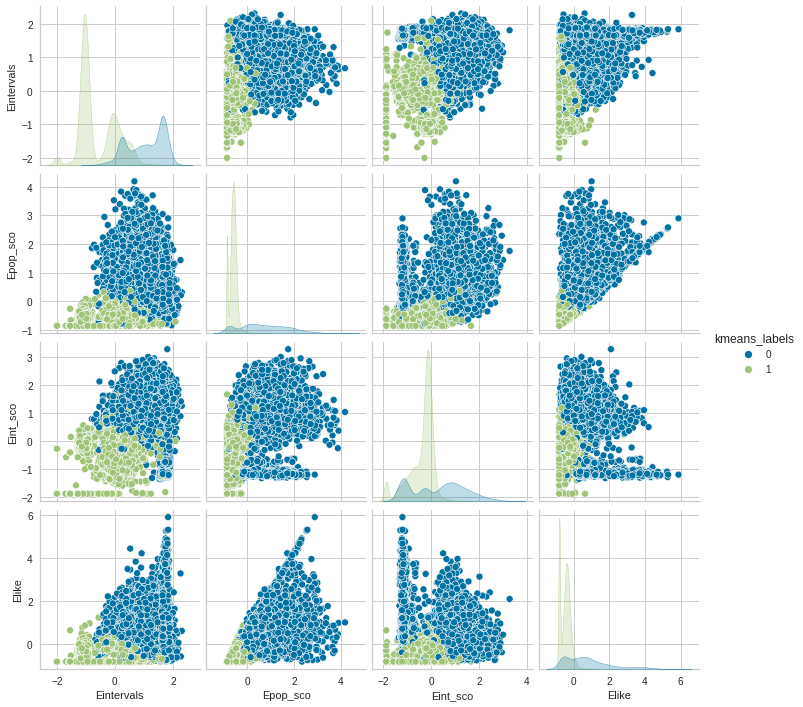

In [ ]:
sns.pairplot(users_norm[['Eintervals', 'Epop_sco', 'Eint_sco', 'Elike', 'kmeans_labels']], hue="kmeans_labels")


Looking at the partitioning of the points in the feature space, the distribution of feature plotted above and statistic computed above we can observe how the two clusters obtained divides the data-points into two distinct groups following a new separation principle.

 By investigating this new separation principle more deeply we can deduce the following observations:
The cluster 0, the more dense and cohesive, contains those points described by low feature values: low popularity score, low interactivity score, low number of tweets posted in certain period etc. 

The cluster 1, the most scattered and least dense, contains those points described by high feature values: high popularity score, high interactivity score, high number of tweets posted in certain period etc. 


Thus, we can say that the cluster process assigns a certain point to a cluster based on a score that, for convention, we call social score. The user's social score depends on his behavior on the platform: the more active, popular and interactive the user is on the platform the higher his social score will be. \

Some additional observations led us to the following final considerations.\
The clustering process divides users into 2 groups by looking at the magnitude (high or low) of the social score obtained. \
We can observe that a larger portion of users are assigned to the cluster that identifies a lower social score, and only a small portion of users are assigned to the cluster defined by an higher social score. This phenomenon leads toward an unbalanced bi-partition of the data that nevertheless reflects what really happens within social networks where few users are distinguished by their high level of popularity/activity/interactivity.\


#### **Cluster visualization in 2D**

In [ ]:
kmeans_labels = users_norm.kmeans_labels

In [ ]:
kmeans_labels

user_id
2353593986    1
2358850842    1
137959629     1
466124818     0
2199062688    0
             ..
2364683192    1
1378532629    0
126984069     1
2383025796    1
933183398     0
Name: kmeans_labels, Length: 9221, dtype: int32

In [ ]:
users_norm.drop(columns ='kmeans_labels', inplace=True)

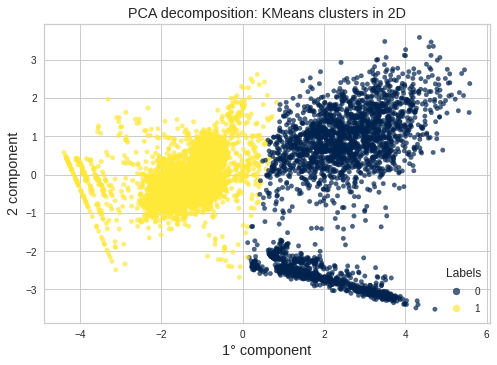

In [ ]:
pca = PCA(n_components=2)

users_norm_pca = pca.fit_transform(users_norm)

sc = plt.scatter(users_norm_pca[:,0], users_norm_pca[:,1], c=kmeans_labels, s=20, alpha=0.7, cmap='cividis')
plt.title('PCA decomposition: KMeans clusters in 2D', fontdict={'fontsize': 'large'})
plt.xlabel('1° component', fontdict={'fontsize': 'large'})
plt.ylabel('2 component', fontdict={'fontsize': 'large'})

plt.legend(*sc.legend_elements(), #legend_elements creates legend handles and labels for a PathCollection.
                        loc="lower right", title="Labels")

plt.show()

#### **Explore 2 clusters with statistics**

In [ ]:
users_norm

,statuses_count,Achars,Schars,Alike,Aemoji,Sretwee,Areply,Sreply,Ahash,Shash,...,Ayears,Adays,pop_sco,itr_sco,Echars,Elike,Ereply,Epop_sco,Eint_sco,Eintervals
user_id,,,,,,,,,,,,,,,,,,,,,
2353593986,-0.293483,-0.338868,-0.135460,-0.142575,-0.401074,-0.252932,-0.06902,-0.066461,-0.156714,-0.038002,...,-0.529817,-0.271336,-0.428861,-0.257045,0.362563,-0.422942,-0.335626,-0.626240,-0.038210,-0.862608
2358850842,-0.294731,-0.041848,0.368969,-0.141539,-0.401074,-0.252931,-0.06902,-0.066461,-0.521961,-0.123759,...,-0.540766,-0.275013,-0.428808,-0.221332,0.224377,-0.330476,-0.335626,-0.589645,-0.199969,-0.938433
137959629,-0.297623,-3.330334,-3.579543,-0.145777,-0.401074,-0.252968,-0.06902,-0.066461,-0.596591,-0.158970,...,-0.644279,-0.388113,-0.429082,-0.704410,-3.295174,-0.822304,-0.335626,-0.858664,-1.885131,-1.541638
466124818,-0.294957,1.344108,-0.395112,-0.131773,0.167853,-0.249846,-0.06902,-0.066461,-0.271305,-0.037933,...,-0.024196,-0.147742,-0.425412,-0.580554,0.851344,0.317934,-0.335626,-0.233642,-1.121279,1.634188
2199062688,0.122197,-1.548330,-1.019810,-0.087185,-0.065959,0.578133,-0.06902,-0.066461,-0.491913,-0.102260,...,0.282859,0.038283,0.892031,0.367707,0.604019,1.502294,-0.335626,2.345964,0.843189,0.682814
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2364683192,-0.294220,-0.196707,-0.313366,-0.141799,-0.401074,-0.252932,-0.06902,-0.066461,-0.141280,-0.040918,...,-0.533799,-0.263621,-0.428825,-0.212406,0.222894,-0.352868,-0.335626,-0.601301,-0.060848,-0.983313
1378532629,-0.126304,-0.629914,0.170448,-0.130052,-0.303296,0.772116,-0.06902,-0.066461,-0.109156,-0.048700,...,-0.022206,-0.162067,0.916214,0.171789,0.920827,0.437178,-0.335626,0.394106,0.874631,0.896890
126984069,-0.297453,-0.063483,-0.941999,-0.145777,-0.401074,-0.252968,-0.06902,-0.066461,0.068864,-0.053327,...,-0.645274,-0.388113,-0.429082,0.395363,-2.493415,-0.822304,-0.335626,-0.858664,0.455043,-0.943339


In [ ]:
saved_index = users_norm.index
users_norm = scaler.inverse_transform(users_norm)


In [ ]:
users_norm = pd.DataFrame(users_norm, columns = ds_num.columns, index = saved_index)

In [ ]:
users_norm['kmeans_labels'] = kmeans_labels

In [ ]:
users_norm[users_norm.kmeans_labels == 0].describe()

,statuses_count,Achars,Schars,Alike,Aemoji,Sretwee,Areply,Sreply,Ahash,Shash,...,Adays,pop_sco,itr_sco,Echars,Elike,Ereply,Epop_sco,Eint_sco,Eintervals,kmeans_labels
count,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,...,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.000000,3133.0
mean,2773.364481,71.671575,34.499526,0.245498,0.021553,753.248148,0.011127,0.144572,0.104651,0.373627,...,9.370363,157.522681,0.506452,6.547533,0.935500,0.006381,2.041011,1.216583,6.755622,0.0
std,3021.920862,14.415043,4.285515,0.751395,0.015436,721.822842,0.003670,0.248505,0.070888,0.114680,...,9.178849,284.704410,0.209289,0.258474,0.755641,0.006644,1.345759,0.573094,1.415154,0.0
min,509.959733,33.018705,21.216038,-0.194883,0.005918,239.829627,0.010551,0.105590,0.044937,0.310669,...,2.356608,-12.201305,0.237772,4.610471,-0.019640,0.005960,-0.044423,0.351327,2.557621,0.0
25%,622.088607,59.047814,32.932313,-0.126523,0.006782,246.747709,0.010551,0.105590,0.065558,0.345187,...,4.529029,-10.241465,0.285584,6.446172,0.333815,0.005960,1.065380,0.545074,5.455728,0.0
50%,1462.371450,77.583212,34.551652,0.015374,0.016041,363.580291,0.010551,0.105590,0.079402,0.360793,...,5.434029,14.957629,0.500322,6.633808,0.800277,0.005960,1.929743,1.299767,7.032910,0.0
75%,4236.877371,83.743662,37.374878,0.266997,0.036374,1086.229476,0.010551,0.105590,0.114138,0.383233,...,8.245076,200.557157,0.644128,6.715590,1.296984,0.005960,3.034641,1.645169,8.011731,0.0
max,23710.039123,111.308035,46.030104,14.503098,0.109783,5256.122014,0.075135,6.128664,0.559542,2.484324,...,50.734330,1567.557516,1.483461,6.944530,4.049162,0.259076,6.689192,2.770712,9.526611,0.0


In [ ]:
users_norm[users_norm.kmeans_labels == 1].describe()

,statuses_count,Achars,Schars,Alike,Aemoji,Sretwee,Areply,Sreply,Ahash,Shash,...,Adays,pop_sco,itr_sco,Echars,Elike,Ereply,Epop_sco,Eint_sco,Eintervals,kmeans_labels
count,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,...,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.000000,6088.0
mean,531.769133,63.680455,38.880246,1.214616,0.020570,282.885665,0.011407,0.112795,0.093930,0.359531,...,3.283537,12.633409,0.361119,5.250601,0.184072,0.052801,0.273120,0.856530,2.994625,1.0
std,164.505121,8.002902,7.571203,10.408379,0.033432,136.108683,0.004439,0.063410,0.041242,0.030380,...,0.959240,94.464886,0.078405,1.120498,0.160741,0.095078,0.204207,0.269553,1.467584,0.0
min,506.541170,11.270457,3.772620,-0.194883,0.005918,239.820197,0.010551,0.105590,0.044937,0.310669,...,2.233416,-12.206527,0.214060,0.324203,-0.019640,0.005960,-0.065184,0.087315,-0.152402,1.0
25%,515.429434,60.800414,36.817562,-0.194883,0.005918,239.820197,0.010551,0.105590,0.068198,0.342570,...,2.313296,-12.166714,0.310472,4.577469,-0.019640,0.005960,0.169648,0.733644,1.941308,1.0
50%,521.924705,64.333782,38.516163,-0.163611,0.005918,239.882839,0.010551,0.105590,0.083093,0.354674,...,3.731173,-12.134954,0.372499,5.759771,0.199208,0.005960,0.282740,0.953142,2.203408,1.0
75%,528.078118,67.368965,40.559348,-0.144454,0.017103,239.909914,0.010551,0.105590,0.107924,0.370681,...,3.968913,-12.092777,0.397656,6.002229,0.289568,0.005960,0.387235,1.026350,4.254066,1.0
max,8298.814206,128.480366,79.813270,121.064154,0.272087,2645.771621,0.139640,3.286340,0.345175,0.528298,...,20.344232,986.155376,1.165520,6.815482,1.220898,0.598991,2.188820,1.930994,9.033914,1.0


#### **Cluster characterization via categorical attributes**

By analyzing the distribution of users in each cluster wrt to the categorical attribute we can state that the 2 generated cluster do not follow any of these partitions principle. 

######**Lang**
While the first cluster present a clear predominance of english user, the second cluster seems to be well balanced wrt to the language attributes value.

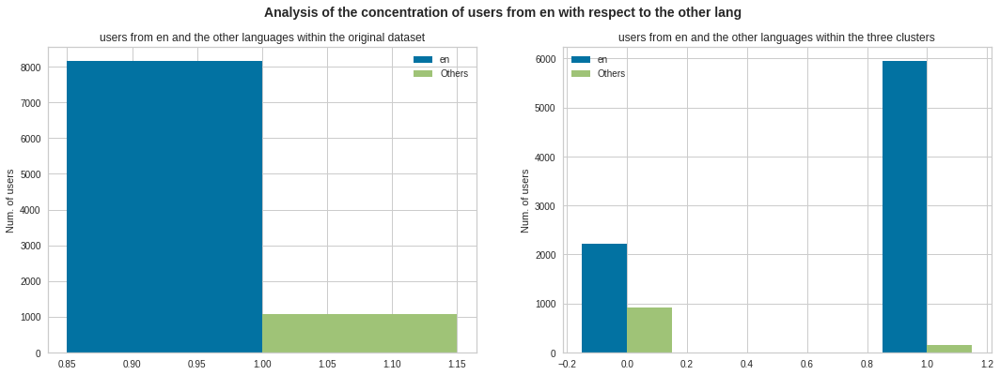

In [ ]:
# dataset of categorical attributes (name and user_created_at are useless for our purpose)
ds_cat = ds[ds.dbscan_label!=-1].iloc[:,[1,2,15,19,20,21]]

tmp_ds = pd.concat([ds_cat, ds_labels], axis=1)
cluster_labels = "k-means-2"

en_tot = len(tmp_ds[tmp_ds.lang == 'en'])
others_tot = len(tmp_ds[tmp_ds.lang != 'en'])
en_bar = tmp_ds[tmp_ds.lang == 'en'].groupby([cluster_labels, 'lang']).size().unstack()
en_bar['Others'] = pd.DataFrame(tmp_ds[tmp_ds.lang != 'en'].groupby([cluster_labels]).size())

width = 0.15

x = np.arange(k)
f, axs = plt.subplots(ncols=2, figsize=(18,6))
axs[0].bar(1 - width/2, en_tot, width, label='en')
axs[0].bar(1 + width/2, others_tot, width, label='Others')
axs[0].legend()
axs[0].set_ylabel('Num. of users')
axs[0].set_title('users from en and the other languages within the original dataset')

axs[1].bar(x - width/2, en_bar['en'], width, label='en')
axs[1].bar(x + width/2, en_bar['Others'], width, label='Others')
axs[1].legend()
axs[1].set_ylabel('Num. of users')
axs[1].set_title('users from en and the other languages within the three clusters')

plt.suptitle(("Analysis of the concentration of users from en with respect to the other lang "),
             fontsize=14, fontweight='bold')

plt.show()

However if we don't consider the english user we can see a clear predominance of italian user in the second cluster. 

In [ ]:
cross_lang = pd.crosstab(tmp_ds[tmp_ds.lang != 'en'][cluster_labels], tmp_ds[tmp_ds.lang != 'en'].lang)
cross_lang

lang,es,fr,id,it,ja,oth,pt,ru,tr,zh
k-means-2,,,,,,,,,,
0,57,8,2,815,13,9,3,0,2,9
1,100,3,2,10,2,1,13,7,4,2


In [ ]:
for i in range(len(cross_lang)):
    cross_lang.loc[i] = (cross_lang.loc[i] / cross_lang.loc[i].sum())*100
cross_lang

lang,es,fr,id,it,ja,oth,pt,ru,tr,zh
k-means-2,,,,,,,,,,
0,6.209150,0.871460,0.217865,88.779956,1.416122,0.980392,0.326797,0.000000,0.217865,0.980392
1,69.444444,2.083333,1.388889,6.944444,1.388889,0.694444,9.027778,4.861111,2.777778,1.388889


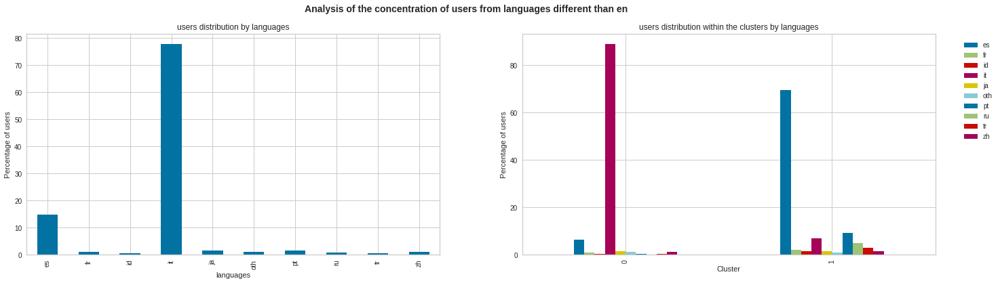

In [ ]:
f, axs = plt.subplots(ncols=2, figsize=(24,6))

lang_percentage = (tmp_ds[tmp_ds.lang != 'en'].lang.value_counts().sort_index() / len(tmp_ds[tmp_ds.lang != 'en']))*100
lang_percentage.plot(kind='bar', legend=False, ax=axs[0])
axs[0].set_xlabel('languages')
axs[0].set_ylabel('Percentage of users')
axs[0].set_title('users distribution by languages')

cross_lang.plot(kind='bar', stacked=False, ax=axs[1])
axs[1].set_xlabel('Cluster')
axs[1].set_ylabel('Percentage of users')
axs[1].set_title('users distribution within the clusters by languages')
axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.8)

plt.suptitle(("Analysis of the concentration of users from languages different than en"),
             fontsize=14, fontweight='bold')

plt.show()

###### **Fyear, Fmonth, Fday**

The following chart show the distribution of users in each cluster wrt to Fyear, Fmonth, Fday:

In [ ]:
# Create cross table
cross_year = pd.crosstab(tmp_ds[cluster_labels], tmp_ds.Fyear)
cross_year

Fyear,2013,2014,2015,2016,2017,2018,2019,2020
k-means-2,,,,,,,,
0,1,5,14,24,77,195,1831,986
1,0,30,52,80,1235,1221,3422,48


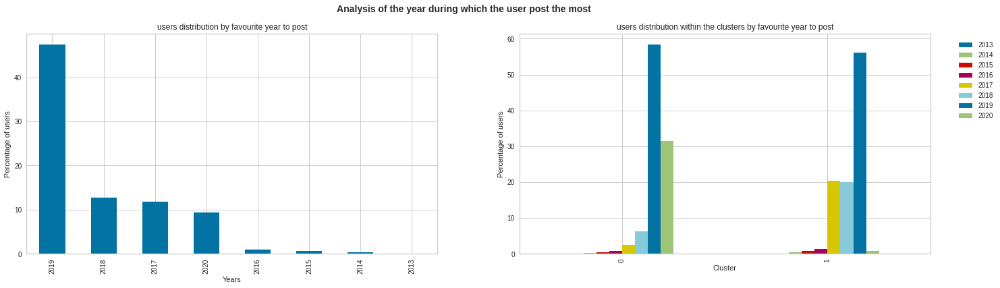

In [ ]:

for i in range(len(cross_year)):
    cross_year.loc[i] = (cross_year.loc[i] / cross_year.loc[i].sum())*100
    
f, axs = plt.subplots(ncols=2, figsize=(24,6))

percentage = (tmp_ds.Fyear.value_counts().to_frame() / len(tmp) ) * 100
percentage.plot(kind='bar', legend=False, ax=axs[0])
axs[0].set_xlabel('Years')
axs[0].set_ylabel('Percentage of users')
axs[0].set_title('users distribution by favourite year to post')

cross_year.plot(kind='bar', stacked=False, ax=axs[1])
axs[1].set_xlabel('Cluster')
axs[1].set_ylabel('Percentage of users')
axs[1].set_title('users distribution within the clusters by favourite year to post')
axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.8)

plt.suptitle(("Analysis of the year during which the user post the most"),
             fontsize=14, fontweight='bold')

plt.show()

In [ ]:
# Create cross table
cross_mnt = pd.crosstab(tmp_ds[cluster_labels], tmp_ds.Fmonth)
cross_mnt

Fmonth,1,2,3,4,5,6,7,8,9,10,11,12
k-means-2,,,,,,,,,,,,
0,267,297,440,533,88,94,149,12,4,384,864,1
1,36,645,410,2625,561,437,361,25,45,711,118,114


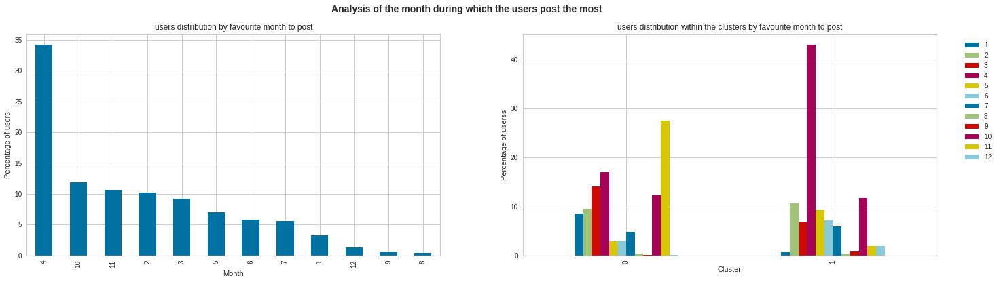

In [ ]:
for i in range(len(cross_mnt)):
    cross_mnt.loc[i] = (cross_mnt.loc[i] / cross_mnt.loc[i].sum())*100

f, axs = plt.subplots(ncols=2, figsize=(24,6))

percentage = ( tmp_ds.Fmonth.value_counts().to_frame() / len(tmp_ds) ) * 100
percentage.plot(kind='bar', legend=False, ax=axs[0])
axs[0].set_xlabel('Month')
axs[0].set_ylabel('Percentage of users')
axs[0].set_title('users distribution by favourite month to post')

cross_mnt.plot(kind='bar', stacked=False, ax=axs[1])
axs[1].set_xlabel('Cluster')
axs[1].set_ylabel('Percentage of userss')
axs[1].set_title('users distribution within the clusters by favourite month to post')
axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.8)

plt.suptitle(("Analysis of the month during which the users post the most"),
             fontsize=14, fontweight='bold')

plt.show()

In [ ]:
cross_day = pd.crosstab(tmp_ds[cluster_labels], tmp_ds.Fday)
cross_day

Fday,0,1,2,3,4,5,6
k-means-2,,,,,,,
0,279,316,374,440,686,479,559
1,863,476,776,1623,1124,565,661


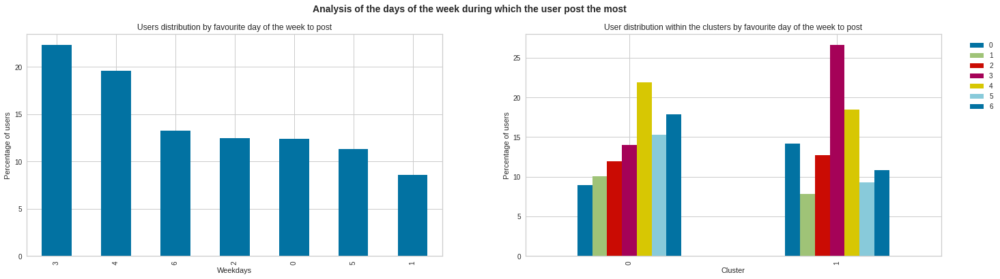

In [ ]:
for i in range(len(cross_day)):
    cross_day.loc[i] = (cross_day.loc[i] / cross_day.loc[i].sum())*100

f, axs = plt.subplots(ncols=2, figsize=(24,6))

week_percentage = (tmp_ds.Fday.value_counts().to_frame() / len(tmp_ds)) * 100
week_percentage.plot(kind='bar', legend=False, ax=axs[0])
axs[0].set_xlabel('Weekdays')
axs[0].set_ylabel('Percentage of users')
axs[0].set_title('Users distribution by favourite day of the week to post')

cross_day.plot(kind='bar', stacked=False, ax=axs[1])
axs[1].set_xlabel('Cluster')
axs[1].set_ylabel('Percentage of users')
axs[1].set_title('User distribution within the clusters by favourite day of the week to post')
axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.8)

plt.suptitle(("Analysis of the days of the week during which the user post the most"),
             fontsize=14, fontweight='bold')

plt.show()

###### **Real**
By looking at the chart below we can asses that the resulting cluster are more or less well-balance wrt real attributes (despite the fact first cluster contains more genuine users and the second one contains more bot users).

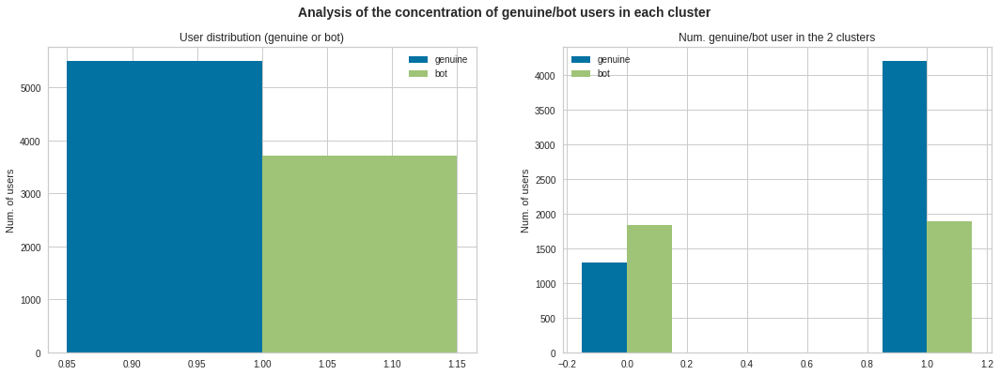

In [ ]:
real_tot = len(tmp_ds[tmp_ds.real == True])
bot_tot  = len(tmp_ds[tmp_ds.real == False])

real_bar = pd.DataFrame()
real_bar["genuine"] = tmp_ds[tmp_ds.real == True].groupby([cluster_labels, 'real']).size().unstack()
real_bar["bot"]  = tmp_ds[tmp_ds.real == False].groupby([cluster_labels, 'real']).size().unstack()


width = 0.15
x = np.arange(k)

f, axs = plt.subplots(ncols=2, figsize=(18,6))

axs[0].bar(1 - width/2, real_tot, width, label='genuine')
axs[0].bar(1 + width/2, bot_tot, width, label='bot')
axs[0].legend()
axs[0].set_ylabel('Num. of users')
axs[0].set_title('User distribution (genuine or bot)')

axs[1].bar(x - width/2, real_bar["genuine"], width, label='genuine')
axs[1].bar(x + width/2, real_bar["bot"], width, label='bot')
axs[1].legend()
axs[1].set_ylabel('Num. of users')
axs[1].set_title('Num. genuine/bot user in the 2 clusters')

plt.suptitle(("Analysis of the concentration of genuine/bot users in each cluster"),
             fontsize=14, fontweight='bold')

plt.show()

We can conclude that the derived cluster criteria does not match with any of this categorical attributes.

##### **Additional metrics evaluation**

In [ ]:
temp, sim, hom, compl, mutinfo=[], [], [], [], []

# wrt categorical features
for column in ds_cat:
    temp.append(column)
    sim.append(metrics.adjusted_rand_score(ds_cat[column], tmp_ds[cluster_labels]))
    hom.append(metrics.homogeneity_score(ds_cat[column], tmp_ds[cluster_labels]))
    compl.append(metrics.completeness_score(ds_cat[column], tmp_ds[cluster_labels]))
    mutinfo.append(metrics.normalized_mutual_info_score(ds_cat[column], tmp_ds[cluster_labels], average_method='arithmetic'))

t = {
    "Feature":temp,
    "Similarity":sim,
    "Homogeneity":hom,
    "Completeness":compl,
    "Mutual Information":mutinfo
}
pd.DataFrame(t).set_index(['Feature'])

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/cluster/_supervised.py:65: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/cluster/_supervised.py:65: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/cluster/_supervised.py:65: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/cluster/_supervised.py:65: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)


,Similarity,Homogeneity,Completeness,Mutual Information
Feature,,,,
lang,0.191274,0.227100,0.160208,0.187877
real,0.092302,0.052391,0.055129,0.053725
Aments,0.015348,0.077898,0.842811,0.142615
Fyear,0.056878,0.118483,0.229089,0.156187
Fmonth,0.090133,0.067174,0.213769,0.102225
Fday,0.016658,0.010561,0.031277,0.015791


## **Hierarchical Clustering**

We use a hierarchical clustering approaches to try to identify hierarchical/nested structure within the clusters by visualizing them as dendograms.

The tree structure of the dendograms allows us to identify the merging of two nodes thanks to horizontal lines and the distance between nodes thanks to the vertical lines. The number of obtained clusters depends of the height used for cutting the tree.

We have considered the following linkage method and the corresponding algorithms for performing the agglomerative clustering process: 
* ward: it minimizes the variance of the clusters being merged. (Incremental alg.) 
* average: it uses the average of the distances of each observation of the two sets. (UPGMA alg.)
* complete: it uses the maximum distances between all observations of the two sets. (Frathest Point alg.)
* single: it uses the minimum of the distances between all observations of the two sets. (Nearest Point alg.)

Nearest Point', 'Farthest Point', 'UPGMA', 'Incremental']})

In [ ]:
hierarchical  = pd.DataFrame(data = {'method': ['single', 'complete', 'average', 'ward'],
                                    'algorithm': ['Nearest Point', 'Farthest Point', 'UPGMA', 'Incremental']})

In [ ]:
hierarchical

,method,algorithm
0,single,Nearest Point
1,complete,Farthest Point
2,average,UPGMA
3,ward,Incremental


### **Hierarchical clustering with default optimal cut**

Usually the optimal number of cluster in hierarchical method can be derived by analysing the corresponding dendogram. In fact, thanks to the color_threshold parameter of the dendogram function (from scipy) it is possible to visualize with different color each cluster under a certain height (suggested by the aforementioned parameter); in this we can obtain some insight about the possible main clusters. 



#### Compute default height for cutting dendograms
in this section we have used the default color threshold rule proposed by Scipy for cutting the tree for cutting dendograms.

In [ ]:
# compute default_color_treshold
def compute_default_treshold(linkage_method):
  Z = linkage(users_norm, linkage_method)
  # this is a standard rule for computing threshold
  default_threshold = 0.7 * max(Z[:,2])
  return default_threshold

hierarchical["default_treshold"] = hierarchical.apply(lambda x: compute_default_treshold(x['method']), axis=1)
hierarchical

,method,algorithm,default_treshold
0,single,Nearest Point,17.192127
1,complete,Farthest Point,57.605595
2,average,UPGMA,28.543141
3,ward,Incremental,191.785321


External function for improving dendogram visualization.

In [ ]:
# this function for improving dendogram visualization is avaialable at:
# ----> https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html

def plot_dendrogram(model, **kwargs):

    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]

        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_, counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

Compare dendograms resulting form different linkage method (and algorithms) with default color thresholds.

In [ ]:
# prepare dataframe for storing computed label of each sample
ds_labels = pd.DataFrame(data={"user_id": ds.index})
ds_labels.set_index("user_id", inplace=True)

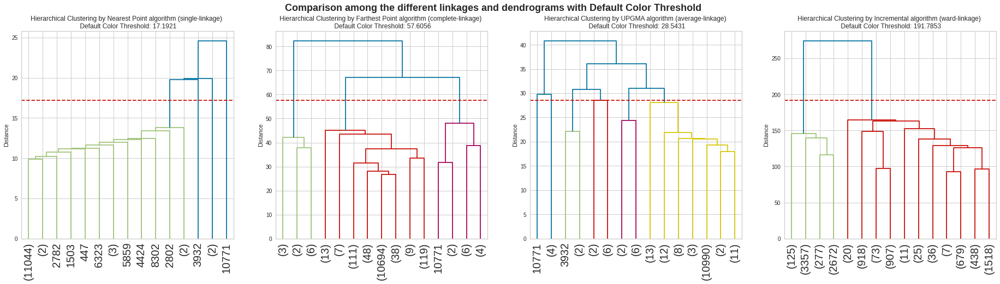

In [ ]:
# plot different dendograms

f, axs = plt.subplots(ncols=4, figsize=(32,7))
for i in hierarchical.index: 
  
  model = AgglomerativeClustering(distance_threshold = 0, 
                                  n_clusters = None, 
                                  linkage = hierarchical.method[i])
  model = model.fit(users_norm) 
  plot_dendrogram(model, 
                  truncate_mode='lastp', 
                  p=15,  
                  leaf_rotation=90,
                  leaf_font_size = 20, 
                  color_threshold = hierarchical.default_treshold[i],
                  ax=axs[i])
      
  axs[i].set_title('Hierarchical Clustering by ' + hierarchical.algorithm[i] + ' algorithm (' + hierarchical.method[i] + '-linkage) \n Default Color Threshold: ' + '{:2.4f}'.format(hierarchical.default_treshold[i]))
  axs[i].set_xlabel('')
  axs[i].set_ylabel('Distance')
  axs[i].axhline(hierarchical.default_treshold[i], ls='--', color='r')

plt.suptitle(('Comparison among the different linkages and dendrograms with Default Color Threshold'),
             fontsize=18, fontweight='bold')
plt.show()

Derive optimal number of cluster looking at the above dendograms.

In [ ]:
hierarchical['num_clusters'] = [2, 3, 6, 2]
hierarchical

,method,algorithm,default_treshold,num_clusters
0,single,Nearest Point,17.192127,2
1,complete,Farthest Point,57.605595,3
2,average,UPGMA,28.543141,6
3,ward,Incremental,191.785321,2


Perform agglomeritive clustering using the previous optimal number of cluster, then predict labels for each samples. 

In [ ]:
for i in hierarchical.index:
  model = AgglomerativeClustering(
      n_clusters = int(hierarchical.num_clusters[i]),
      affinity = 'euclidean',
      linkage = hierarchical.method[i]
      )
  labels = model.fit_predict(users_norm)  
  ds_labels[hierarchical.method[i]] = labels

ds_labels

,single,complete,average,ward
user_id,,,,
2353593986,0,2,2,1
2358850842,0,2,2,1
137959629,0,2,2,1
466124818,0,2,2,0
2571493866,0,2,2,0
...,...,...,...,...
1901595415,0,2,2,0
1378532629,0,2,2,0
126984069,0,2,2,1


Compare hierarchical clustering results by visualizing the points distribution within each obtained cluster partition.

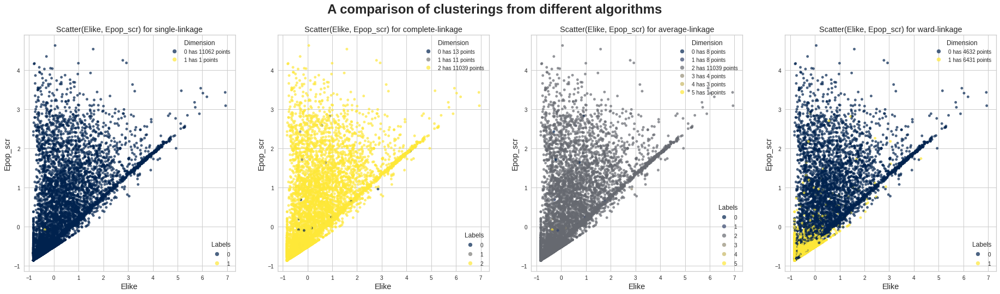

In [ ]:
f, axs = plt.subplots(nrows=1, ncols=4, figsize=(32,8))

for i in hierarchical.index:
  labels = ds_labels[hierarchical.method[i]]
                                    
  sc = axs[i].scatter(users_norm['Elike'], users_norm['Epop_sco'], c=labels, s=20, alpha=0.7, cmap='cividis')
    
  axs[i].set_title('Scatter(Elike, Epop_scr) for ' + hierarchical.method[i] + '-linkage', fontdict={'fontsize': 'large'})
  axs[i].set_xlabel('Elike', fontdict={'fontsize': 'large'})
  axs[i].set_ylabel('Epop_scr', fontdict={'fontsize': 'large'})
    
  # produce a legend with the unique colors from the scatter
  population = np.unique(labels, return_counts=True)

  legend1 = axs[i].legend(*sc.legend_elements(), #legend_elements creates legend handles and labels for a PathCollection.
                        loc="lower right", title="Labels")
    
  axs[i].add_artist(legend1)

  # produce a legend 
  secondlegend = []
  classes = np.unique(labels).shape[0]

  for j in range(classes):
    secondlegend.append("{} has {} points".format(j, population[1][j]))
  handles = sc.legend_elements()[0]
  labels_2 = secondlegend
  legend2 = axs[i].legend(handles, labels_2, loc="upper right", title="Dimension")

plt.suptitle(('A comparison of clusterings from different algorithms'),
             fontsize=24, fontweight='bold')
    
plt.show()

reduce dataset dimension with PCA decomposition and compare sample partition obtained with different method. 

In [ ]:

pca = PCA(n_components = 2)
users_norm_pca = pca.fit_transform(users_norm)

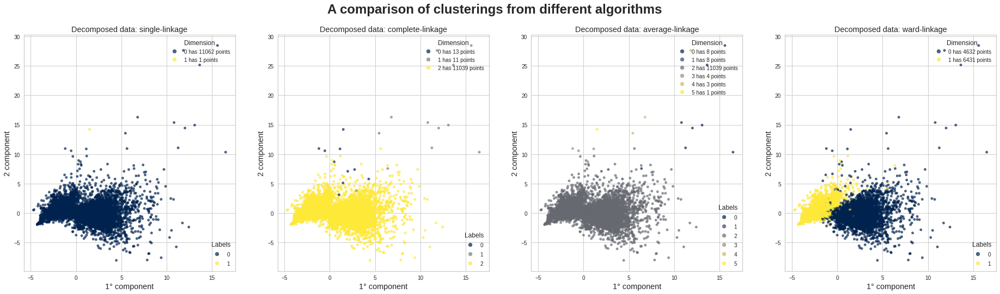

In [ ]:
f, axs = plt.subplots(nrows=1, ncols=4, figsize=(32,8))

for i in hierarchical.index:
  labels = ds_labels[hierarchical.method[i]]
                                    
  sc = axs[i].scatter(users_norm_pca[:,0], users_norm_pca[:,1], c=labels, s=20, alpha=0.7, cmap='cividis')
    
  axs[i].set_title('Decomposed data: ' + hierarchical.method[i] + '-linkage', fontdict={'fontsize': 'large'})
  axs[i].set_xlabel('1° component', fontdict={'fontsize': 'large'})
  axs[i].set_ylabel('2 component', fontdict={'fontsize': 'large'})
    
  # produce a legend with the unique colors from the scatter
  population = np.unique(labels, return_counts=True)

  legend1 = axs[i].legend(*sc.legend_elements(), #legend_elements creates legend handles and labels for a PathCollection.
                        loc="lower right", title="Labels")
    
  axs[i].add_artist(legend1)

  # produce a legend 
  secondlegend = []
  classes = np.unique(labels).shape[0]

  for j in range(classes):
    secondlegend.append("{} has {} points".format(j, population[1][j]))
  handles = sc.legend_elements()[0]
  labels_2 = secondlegend
  legend2 = axs[i].legend(handles, labels_2, loc="upper right", title="Dimension")

plt.suptitle(('A comparison of clusterings from different algorithms'),
             fontsize=24, fontweight='bold')
    
plt.show()

In [ ]:
list_dav, list_sil, list_cal,list_cop = [], [], [], []


for i in hierarchical.index:
  
  dav = davies_bouldin_score(users_norm, ds_labels[hierarchical.method[i]])
  sil = silhouette_score(users_norm, ds_labels[hierarchical.method[i]])
  cal = calinski_harabasz_score(users_norm, ds_labels[hierarchical.method[i]])
  Z = linkage(users_norm, hierarchical.method[i])

  list_cop = np.append(list_cop, np.corrcoef(pdist(users_norm), cophenet(Z))[0][1])
  list_dav.append(dav)
  list_sil.append(sil)
  list_cal.append(cal)

hierarchical['davies bouldin'] = list_dav
hierarchical['silhouette']     = list_sil
hierarchical['calinski harabasz']  = list_cal
hierarchical['cophentic']  = list_cop

hierarchical

,method,algorithm,default_treshold,num_clusters,davies bouldin,silhouette,calinski harabasz,cophentic
0,single,Nearest Point,17.192127,2,0.064508,0.905647,146.295631,0.889774
1,complete,Farthest Point,57.605595,3,0.775041,0.845671,585.918073,0.841317
2,average,UPGMA,28.543141,6,0.615748,0.827920,289.504560,0.925785
3,ward,Incremental,191.785321,2,1.830546,0.281904,1913.841476,0.373368


Although the magnitudes of the other metrics seem to favor solutions different from the one proposed by the ward algorithm, the visualization of the clusters via scatter plot (as well as calinski harabasz score) led us to conclude that the best solution achieved through a hierarchical approach is the one proposed by the ward linkage algorithm.

#### Clusters characterization for WARD Linkage with statistics and distributions analysis

In [ ]:
users_norm['ward_label'] = ds_labels['ward']

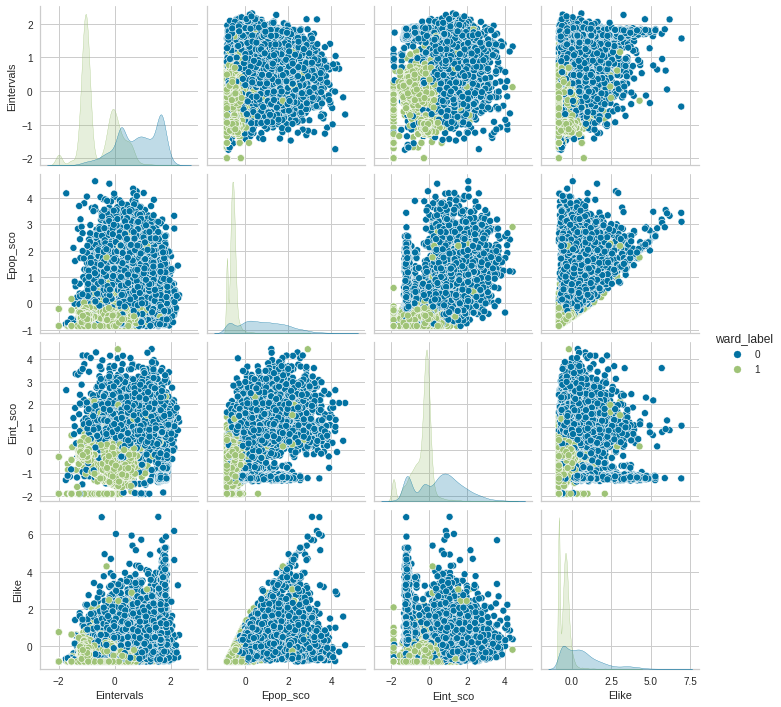

In [ ]:
sn.pairplot(users_norm[['Eintervals', 'Epop_sco', 'Eint_sco', 'Elike', 'ward_label']], hue="ward_label")

In [ ]:
users_norm[users_norm.ward_label == 0].describe()

,statuses_count,Achars,Schars,Alike,Aemoji,Sretwee,Areply,Sreply,Ahash,Shash,...,Adays,pop_sco,itr_sco,Echars,Elike,Ereply,Epop_sco,Eint_sco,Eintervals,ward_label
count,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,...,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.000000,4632.0
mean,0.407238,0.337124,-0.292017,-0.074615,-0.079164,0.301518,0.031857,0.068848,0.205565,0.088573,...,0.451502,0.409512,0.390140,0.648345,0.654012,-0.300335,0.813296,0.550184,0.835019,0.0
std,1.449122,1.196795,0.630102,0.357334,0.422809,1.485279,1.442403,1.526443,1.428731,1.537719,...,1.422479,1.326749,1.421283,0.403786,1.226231,0.438373,1.084138,1.193502,0.767520,0.0
min,-0.297736,-3.150406,-4.347464,-0.145777,-0.401074,-0.252968,-0.069020,-0.066461,-0.596591,-0.158970,...,-0.408455,-0.429082,-0.704410,-4.565932,-0.822304,-0.335626,-0.858664,-1.885131,-1.994234,0.0
25%,-0.274542,-0.647625,-0.549985,-0.140243,-0.389428,-0.245293,-0.069020,-0.066461,-0.406334,-0.091355,...,-0.222866,-0.419072,-0.228917,0.616155,-0.315410,-0.335626,0.000706,-0.291816,0.238140,0.0
50%,-0.073450,0.637213,-0.326454,-0.127840,-0.245423,-0.104632,-0.069020,-0.066461,-0.256228,-0.056490,...,-0.138715,-0.226902,0.233299,0.773105,0.411703,-0.335626,0.726219,0.644996,0.905551,0.0
75%,0.410934,1.241387,0.133599,-0.103788,0.197408,0.406203,-0.069020,-0.066461,0.334282,0.000108,...,0.489059,0.664370,0.676522,0.865936,1.221832,-0.335626,1.592487,1.347653,1.592306,0.0
max,22.360753,7.159911,3.598145,7.354779,5.192882,17.610165,44.095479,50.206915,40.129240,51.064222,...,13.301958,6.039695,33.374908,1.440204,6.942127,13.546610,4.636558,4.413199,2.302402,0.0


In [ ]:
users_norm[users_norm.ward_label == 1].describe()

,statuses_count,Achars,Schars,Alike,Aemoji,Sretwee,Areply,Sreply,Ahash,Shash,...,Adays,pop_sco,itr_sco,Echars,Elike,Ereply,Epop_sco,Eint_sco,Eintervals,ward_label
count,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,...,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.000000,6431.0
mean,-0.293318,-0.242817,0.210329,0.053742,0.057019,-0.217172,-0.022946,-0.049589,-0.148061,-0.063796,...,-0.325199,-0.294956,-0.281002,-0.466978,-0.471060,0.216320,-0.585786,-0.396276,-0.601432,1.0
std,0.050853,0.740342,1.152783,1.273447,1.258575,0.137936,0.469935,0.191123,0.444974,0.088286,...,0.102881,0.494911,0.277550,1.040284,0.327902,1.212577,0.233085,0.565243,0.657417,0.0
min,-0.297793,-4.260630,-4.347464,-0.145777,-0.401074,-0.252968,-0.069020,-0.066461,-0.596591,-0.158970,...,-0.408455,-0.429082,-0.704410,-4.565932,-0.822304,-0.335626,-0.858664,-1.885131,-1.994234,1.0
25%,-0.296432,-0.506655,-0.094879,-0.145777,-0.401074,-0.252968,-0.069020,-0.066461,-0.398931,-0.099603,...,-0.402196,-0.428919,-0.440943,-1.044006,-0.822304,-0.335626,-0.683375,-0.648214,-1.066686,1.0
50%,-0.295298,-0.225191,0.133644,-0.142794,-0.401074,-0.252925,-0.069020,-0.066461,-0.266158,-0.075288,...,-0.290279,-0.428784,-0.276720,0.020274,-0.461652,-0.335626,-0.595862,-0.225382,-0.943339,1.0
75%,-0.294277,0.020652,0.430191,-0.140848,-0.017294,-0.252905,-0.061174,-0.062011,-0.026201,-0.043244,...,-0.268131,-0.428587,-0.202045,0.249628,-0.301780,0.341770,-0.514308,-0.075949,-0.038147,1.0
max,2.811813,7.292342,8.267606,25.533023,18.020404,6.219570,19.902145,7.804569,5.522776,2.827707,...,2.999342,5.007846,3.496840,1.813653,4.285341,14.077760,2.899039,4.405212,1.961205,1.0


Here we have reported some feature's statistics and distribution for the 2 clusters. We can observed that this result is very similar to the one obtained with kmeans. In fact WARD linkage seems to partition the users based, again, on a social score: one cluster contains user described by high features values (i.e. high social score) and the othe one contains users characterized by lower social score and lower features values. 

moreover since the clustering characterized by low social score is the bigger one we can derive that the number of user with high interactivity and popularity score is lower then the number of users being highly popular and interactive on Twitter.

Anyway this 2 obtained clusters have a more balanced populations with respect to kmeans. 

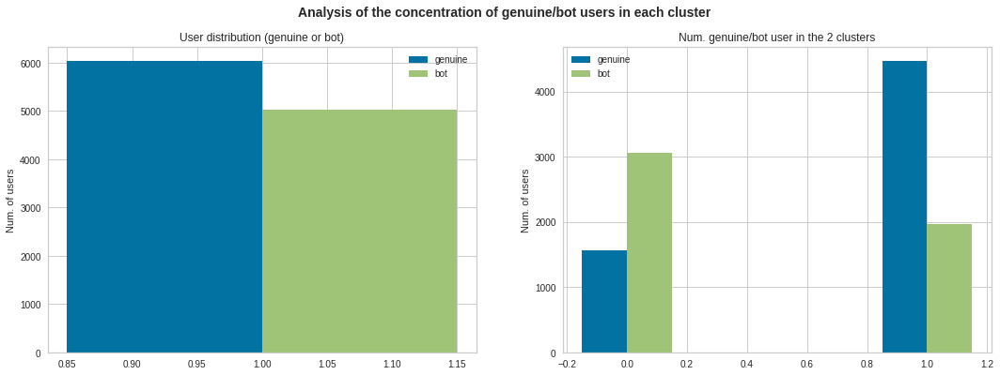

In [ ]:
ds['ward_label'] = ds_labels['ward']
real_tot = len(ds[ds.real == True])
bot_tot  = len(ds[ds.real == False])

real_bar = pd.DataFrame()
real_bar["genuine"] = ds[ds.real == True].groupby(['ward_label', 'real']).size().unstack()
real_bar["bot"]  = ds[ds.real == False].groupby(['ward_label', 'real']).size().unstack()


width = 0.15
x = np.arange(2)

f, axs = plt.subplots(ncols=2, figsize=(18,6))

axs[0].bar(1 - width/2, real_tot, width, label='genuine')
axs[0].bar(1 + width/2, bot_tot, width, label='bot')
axs[0].legend()
axs[0].set_ylabel('Num. of users')
axs[0].set_title('User distribution (genuine or bot)')

axs[1].bar(x - width/2, real_bar["genuine"], width, label='genuine')
axs[1].bar(x + width/2, real_bar["bot"], width, label='bot')
axs[1].legend()
axs[1].set_ylabel('Num. of users')
axs[1].set_title('Num. genuine/bot user in the 2 clusters')

plt.suptitle(("Analysis of the concentration of genuine/bot users in each cluster"),
             fontsize=14, fontweight='bold')

plt.show()

This chart also reconfirm that neither in this case the clustering principle follow exactly the genuine/bot partition principle. 
Anyway we can clearly see a predominance of bot users in cluster 0 and a predominance of genuine users in clusters 1. 

### **Analyze clusters by changing the height of the cut**

We have already choose the best hierarchical clustering method, but we also want to study how obtained clusters change by changing the height used for cutting dendograms. 

In [ ]:
# compute a customized treshold
def compute_tresholds(linkage_method):
  
  try_treshold = []
  treshold_coefficent = [0.4, 0.5, 0.6, 0.8, 0.9]
  Z = linkage(users_norm, linkage_method)

  for i in range(5):
    treshold =  treshold_coefficent[i] * max(Z[:,2])
    try_treshold.append(treshold)

  return try_treshold

single_threshold = compute_tresholds('single')
complete_threshold = compute_tresholds('complete')
average_threshold = compute_tresholds('average')
ward_threshold = compute_tresholds('ward')

In [ ]:
print("threshold to try out for single method:\n", single_threshold)
print("\n\nthreshold to try out for complete method:\n", complete_threshold)
print("\n\nthreshold to try out for average method:\n", average_threshold)
print("\n\nthreshold to try out for ward method:\n", ward_threshold)

threshold to try out for single method:
 [9.824072655539156, 12.280090819423945, 14.736108983308734, 19.648145311078313, 22.1041634749631]


threshold to try out for complete method:
 [32.917483061261436, 41.146853826576795, 49.376224591892154, 65.83496612252287, 74.06433688783824]


threshold to try out for average method:
 [16.313405970236104, 20.39175746279513, 24.470108955354156, 32.62681194047221, 36.70516343303124]


threshold to try out for ward method:
 [113.45465151355194, 141.8183143919399, 170.18197727032788, 226.90930302710387, 255.27296590549184]


define a function for cutting dendograms at the given precomputed threshold

In [ ]:
def plot_dendogram_changing_cut (method, cut_threshold):

  f, axs = plt.subplots(ncols=5, figsize=(45,7))
  predictions = []

  for i in range(len(cut_threshold)): 
    threshold = cut_threshold[i]
    
    model = AgglomerativeClustering(distance_threshold = threshold, 
                                    n_clusters = None, 
                                    linkage = method)
    labels = model.fit_predict(users_norm) 
    plot_dendrogram(model, 
                    truncate_mode='lastp', 
                    p=15, 
                    leaf_rotation=90,
                    leaf_font_size = 20, 
                    color_threshold = threshold,
                    ax=axs[i])

    
    predictions.append(labels)
        
    axs[i].set_title('Hierarchical Clustering:' +method + '-linkage \n customized Threshold: ' + '{:2.4f}'.format(threshold))
    axs[i].set_xlabel('')
    axs[i].set_ylabel('Distance')
    axs[i].axhline(threshold, ls='--', color='r')

  plt.suptitle(('Comparison among the different dendrograms with customized Threshold'),
              fontsize=18, fontweight='bold')
  plt.show()

  return predictions
  

define a function for visualizing cluster obtained in 2D (thanks to pca) by varying the cut threshold.

In [ ]:

pca = PCA(n_components = 2)
users_norm_pca = pca.fit_transform(users_norm)

In [ ]:
def plot_pca_changing_cut (method, predictions):
  
  f, axs = plt.subplots(ncols=5, figsize=(32,8))
  for i in range(5):
    
    preds = predictions[i]

    sc = axs[i].scatter(users_norm_pca[:,0], users_norm_pca[:,1], c=preds, s=20, alpha=0.7, cmap='Set2')
        
    axs[i].set_title('Decomposed data: ' + method + '-linkage', fontdict={'fontsize': 'large'})
    axs[i].set_xlabel('1° component', fontdict={'fontsize': 'large'})
    axs[i].set_ylabel('2 component', fontdict={'fontsize': 'large'})
        
    # produce a legend with the unique colors from the scatter
    population = np.unique(preds, return_counts=True)

    legend1 = axs[i].legend(*sc.legend_elements(), #legend_elements creates legend handles and preds for a PathCollection.
                            loc="lower right", title="preds")
        
    axs[i].add_artist(legend1)

    # produce a legend 
    secondlegend = []
    classes = np.unique(preds).shape[0]

    for j in range(classes):
      secondlegend.append("{} has {} points".format(j, population[1][j]))
    handles = sc.legend_elements()[0]
    preds_2 = secondlegend
    legend2 = axs[i].legend(handles, preds_2, loc="upper right", title="Dimension")

  plt.suptitle(('A comparison of 2-dim clusters obtained changing cut threshold'),
                fontsize=24, fontweight='bold')
        
  plt.show()


  

#### single method: when we cut the dendograms at different height we cannot see significant difference in the obtained clusters. For every threshold we find a huge cluster contained most of the samples and other cluster containing single observations.

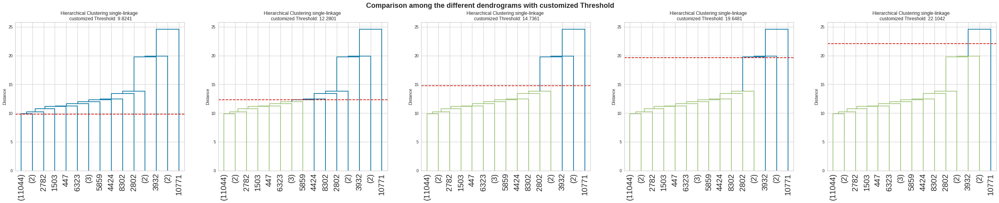

In [ ]:
single_preds = plot_dendogram_changing_cut ('single', single_threshold)

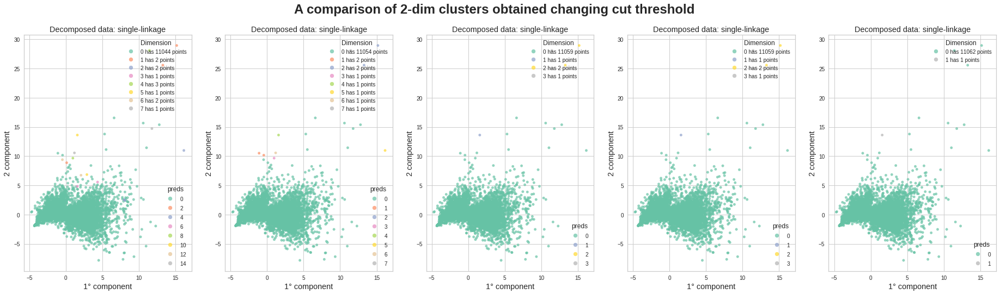

In [ ]:
plot_pca_changing_cut('single', single_preds)

#### complete method: also in this case when we cut the dendograms at different height we always find a huge cluster contained most of the samples and other clusters are still containing single observations.

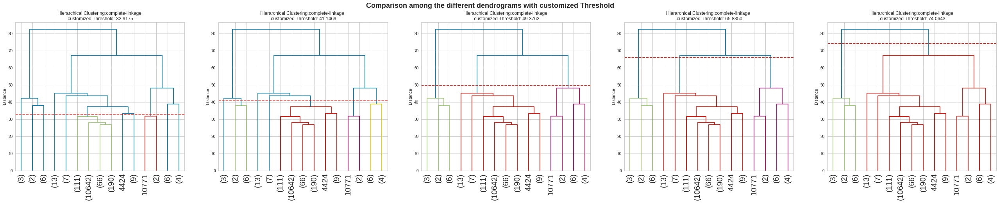

In [ ]:
complete_preds = plot_dendogram_changing_cut ('complete', complete_threshold)


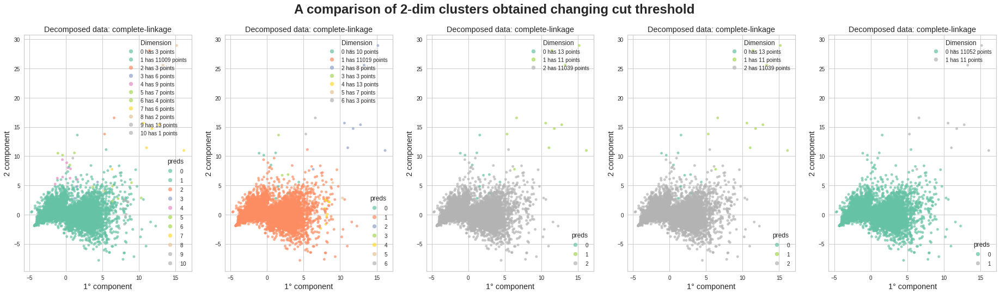

In [ ]:
plot_pca_changing_cut("complete", complete_preds)

#### average method: same things appeared for single and complete appears also for this method.

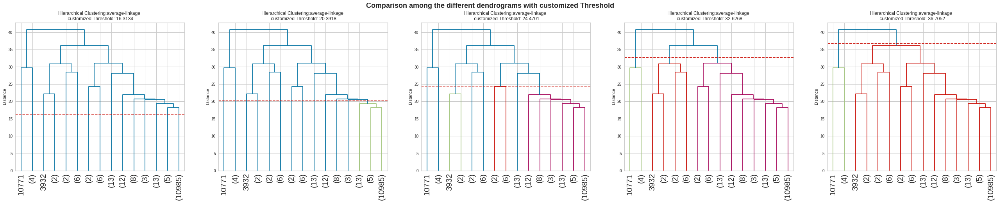

In [ ]:
average_preds = plot_dendogram_changing_cut ('average', average_threshold)

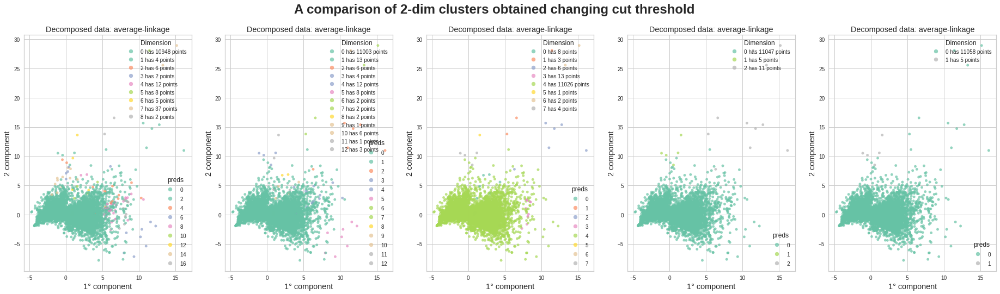

In [ ]:
plot_pca_changing_cut("average", average_preds)

##### Ward method: with this method we can observe significant difference in the resulting cluster by cutting the dendograms at different heights.
coefficient value equal to  0.9, 0.8 and 0.6 lead us to the same partition obtained with scipy standard rule for computing cut-threshold.
With coefficient values equal to 0.5 and 0.4 we obtain very different results: 
* in the first case we obtain 6 clusters: 4 cluster are really more populated, well-defined and cohesive, while the remaining 2 cluster seems to group together some marginal outliers. They are overlapping each other, thus leading to lower separation degree.
* in the second case 11 clusters are detected. It's clear the most of them are non significant clusters but although the bad separation/cohesion we can still visualized them in a clear way.

Of curse this analysis has remarked how scipy standard have returned us the best cut-threshold for our clustering purpose.

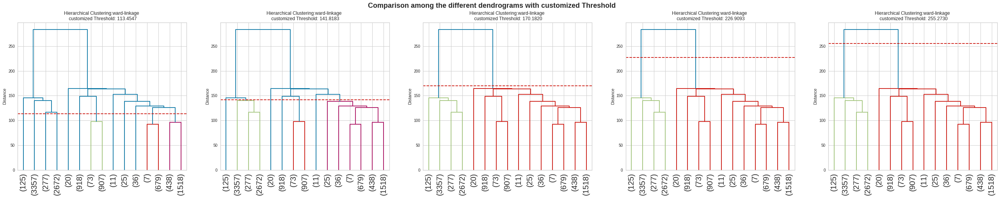

In [ ]:
ward_preds = plot_dendogram_changing_cut ('ward', ward_threshold)

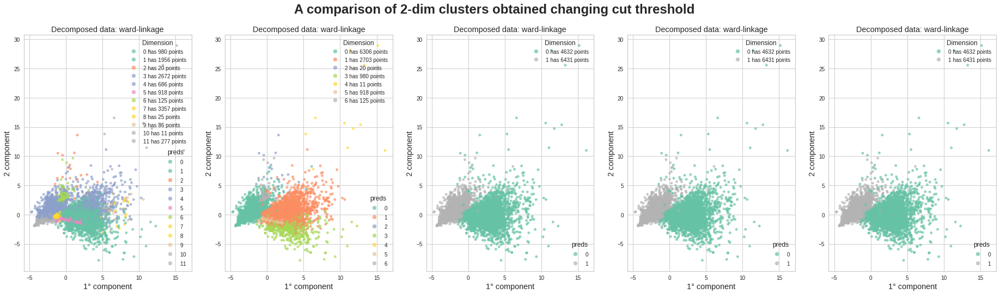

In [ ]:
plot_pca_changing_cut("ward", ward_preds)
  

## Alternative clustering algorithm

### XMeans

X-means clustering method works starting from the assumption of having a minimum number of clusters, and then dynamically increases them. X-means uses specified splitting criterion to control the process of splitting clusters. 
The pyclustering implementation exploits K-Means++ as centers initilization method.

X-means exploits K-means algorithm and makes local decisions about which subset of the current centroids should be splitted to attain a better fit according to a given splitting criterion.

X-Means works by alternatively applying two operations 
* The K-Means algorithm  to optimally detect the clusters for a chosen value of k
* cluster splitting to optimize the value of k according to a specific splitting criterion (i.e, a given metric). 

In this method, the actual value of K is estimated in a way that is not monitored and only based on the data set. Kmax and Kmin as the upper and lower limits for the possible values of X. In the first step of the X-means grouping, know that at present X = Xmin, X-means finding the initial structure and centroid. In the next step, each cluster in the estimated structure is treated as the parent cluster, which can be divided into two groups.

Reference source: https://medium.com/geekculture/x-means-algorithm-a-complement-to-the-k-means-algorithm-b087ae88cf88


we use the normalized dataset reduced to 2 dimension with PCA as input for Xmeans.

In [ ]:
pyclust_data = users_norm_pca.tolist()

In [ ]:
from pyclustering.utils import read_sample
#from pyclustering.samples.definitions import FAMOUS_SAMPLES
from pyclustering.cluster import cluster_visualizer_multidim
 

In [ ]:
def use_xmeans (number_of_clusters):
  # initialize initial centers using K-Means++ algorithm
  centers = kmeans_plusplus_initializer(pyclust_data, number_of_clusters).initialize()
  xmeans_instance = xmeans(pyclust_data, centers,kmax = number_of_clusters)
  xmeans_instance.process()
  clusters = xmeans_instance.get_clusters()
  
  # visualize obtained clusters in multi-dimensional space
  visualizer = cluster_visualizer_multidim()
  visualizer.append_clusters(clusters, pyclust_data)
  visualizer.show(max_row_size=1,visible_axis=True)

show xmeans results initilizing 2,3,4,5 and 6 centers.

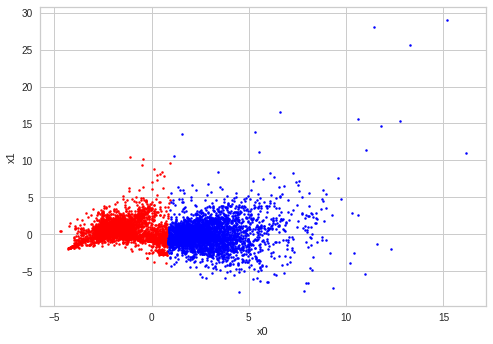

In [ ]:
use_xmeans(number_of_clusters=2)

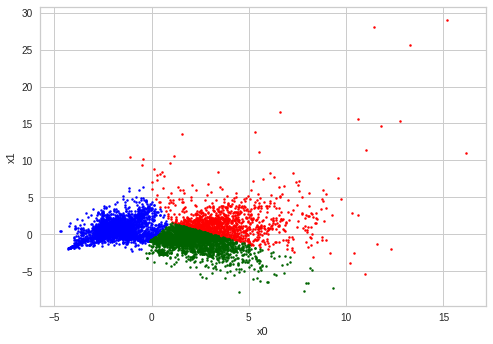

In [ ]:
use_xmeans(number_of_clusters=3)

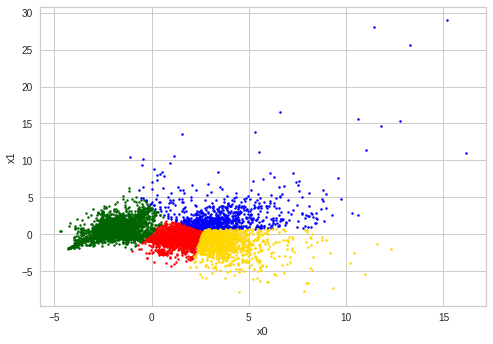

In [ ]:
use_xmeans(number_of_clusters=4)

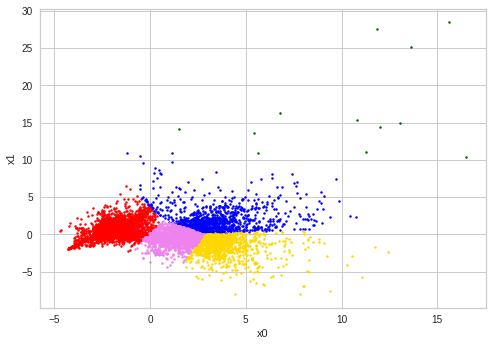

In [ ]:
use_xmeans(number_of_clusters=5)

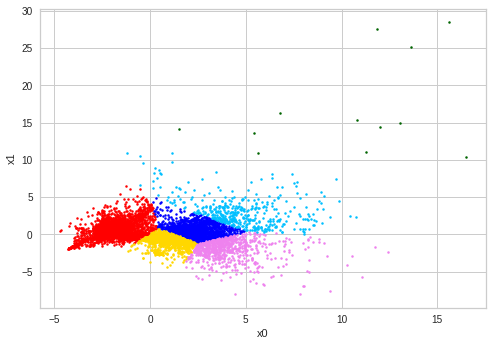

In [ ]:
use_xmeans(number_of_clusters=6)

### SOM (self organizing map) 


SOM is a common unsupervised neural network models widely used for clustering, dimension reduction, and feature detection.
They consist of N neurons located on a regular low dimensional grid; the aims is to learn a mao from input space to the grid of neural units preserving the original topology. This mechanism gives allow good visualization properties of the som ouput features map. 
When using SOM in clustering task clusters can be identified on the map.

Som algorthims works by randomly initilize weights and drown a sample input x, then 2 stage are performed iterativly untill convergence:
* competitive stage: x is compared to all the units weights using euclidian distance, the winner unit is the unit with weights most similar to x
* cooperative stage: update weights weights of the unit that have a topological relationship with the winner unit, moving them closer to input vector x.

Reference source: machine learning course 

We decided to exploits the Self-Organized Feature Map for Simple Clustering(SOM-SC) pyclustering implementation. It is an adaptation of SOM for cluster analysis; the basic idea is that amount of cluster that should be allocated is defined as the amount of neurons in the self-organized map. SOM-SC can be considered as neural network implementation of K-Means algorithm.

In [ ]:
from pyclustering.cluster.somsc import somsc

we define function for using SOM-SC giving as parameter the number of neurons to be allocated on the SOM. 
We still give us input to SOM-SC the dataset reduced in 2 dimension via PCA and we want to visualize the generate cluster partions for detecting similarity with Kmeans and Xmeans results.

In [ ]:
def use_som (number_of_clusters):

  # create instance of SOM-SC algorithm to allocated two clusters
  som_instance = somsc(pyclust_data, number_of_clusters);
  # run cluster analysis and obtain results
  som_instance.process();
  clusters = som_instance.get_clusters();
  
  # visualize obtained clusters in multi-dimensional space
  visualizer = cluster_visualizer_multidim()
  visualizer.append_clusters(clusters, pyclust_data)
  visualizer.show(max_row_size=1,visible_axis=True)

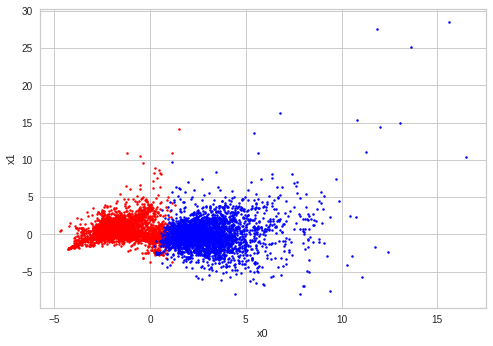

In [ ]:
use_som(2)

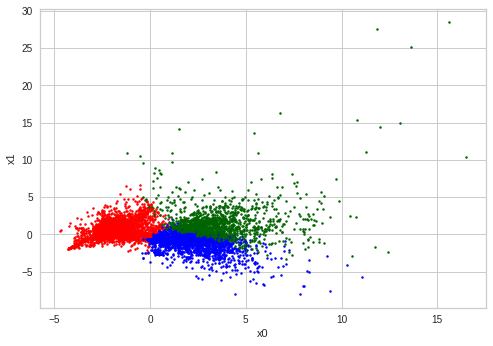

In [ ]:
use_som(3)

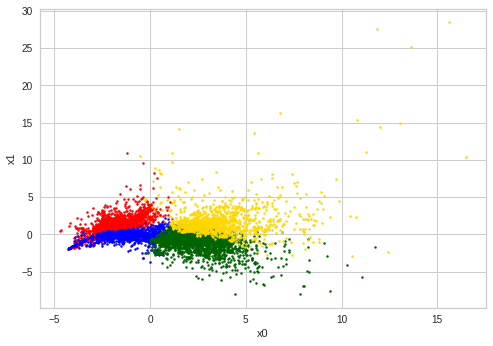

In [ ]:
use_som(4)

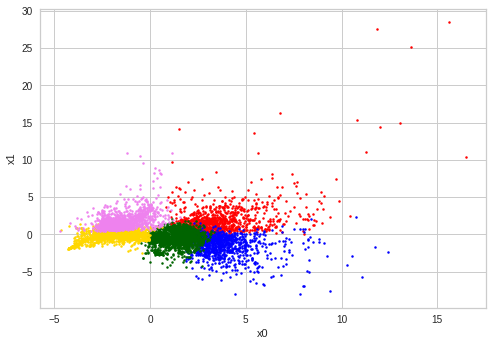

In [ ]:
use_som(5)

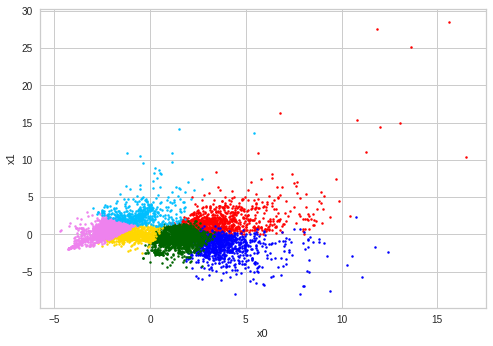

In [ ]:
use_som(6)

Using the classical neural implemention of SOM (still offered by pyclustering) does not allow us to reach any significant conclusion since in this case we start from a dataset reduced in 2 dimension with PCA. 
We can only observe that weights of unit closer to marginal outliers has been updating in order to bring them away from the denser region.

Point '[1.6377830317660518, -1.0488162040800084]' is similar to objects with indexes '[45, 61, 182, 285, 305, 332, 386, 388, 429, 471, 535, 649, 654, 711, 740, 897, 1037, 1070, 1244, 1267, 1273, 1292, 1511, 1533, 1588, 1623, 1752, 1780, 1807, 1828, 1925, 1967, 2028, 2148, 2209, 2282, 2403, 2451, 2455, 2500, 2508, 2642, 2691, 2717, 3133, 3221, 3293, 3436, 3572, 3617, 3641, 3692, 3821, 3827, 3913, 4121, 4174, 4286, 4312, 4439, 4483, 4510, 4569, 4610, 4720, 5012, 5497, 5546, 5631, 5742, 5752, 5759, 5839, 5988, 6073, 6107, 6126, 6154, 6170, 6171, 6252, 6292, 6319, 6488, 6502, 6553, 6566, 6812, 6870, 7010, 7054, 7191, 7407, 7434, 7450, 7561, 7670, 7719, 7778, 7807, 7883, 7942, 8046, 8121, 8159, 8455, 8531, 8635, 8940, 9032, 9120, 9206, 9238, 9347, 9366, 9478, 9486, 9731, 9754, 9790, 9942, 9947, 9993, 10431, 10435, 10531, 10554, 10575, 10577, 10639, 10694, 10705, 10960, 10977, 11002]'.
Coordinates of similar objects:
	Point: [2.0280033513704447, -1.1294934293074426]
	Point: [1.74649517223248

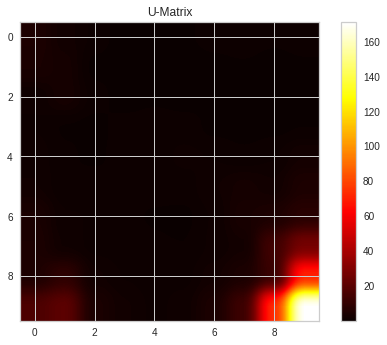

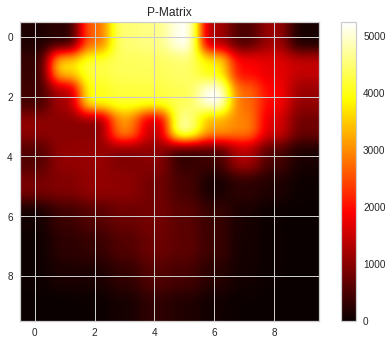

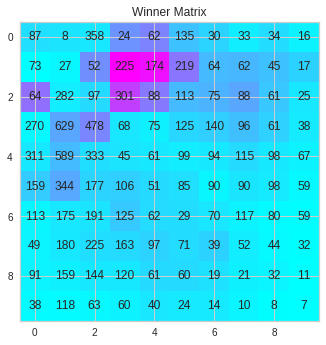

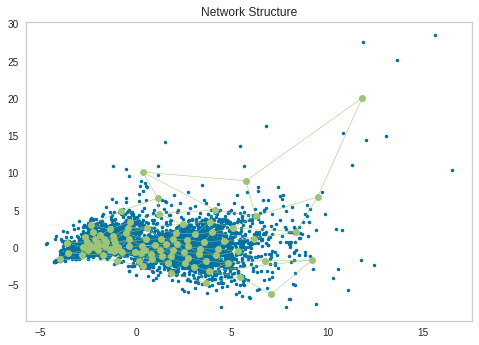

In [ ]:
import random
from pyclustering.utils import read_sample
from pyclustering.nnet.som import som, type_conn, type_init, som_parameters
from pyclustering.samples.definitions import FCPS_SAMPLES

# read sample 'Lsun' from file
sample = pyclust_data

# create SOM parameters
parameters = som_parameters()

# create self-organized feature map with size 7x7
rows = 10  # five rows
cols = 10  # five columns

structure = type_conn.grid_four;  # each neuron has max. four neighbors.
network = som(rows, cols, structure, parameters)

# train network on 'Lsun' sample during 100 epouchs.
network.train(sample, 100)

# simulate trained network using randomly modified point from input dataset.
index_point = random.randint(0, len(sample) - 1)

point = sample[index_point]  # obtain randomly point from data
point[0] += random.random() * 0.2  # change randomly X-coordinate
point[1] += random.random() * 0.2  # change randomly Y-coordinate
index_winner = network.simulate(point)

# check what are objects from input data are much close to randomly modified.
index_similar_objects = network.capture_objects[index_winner]
# neuron contains information of encoded objects
print("Point '%s' is similar to objects with indexes '%s'." % (str(point), str(index_similar_objects)))
print("Coordinates of similar objects:")
for index in index_similar_objects: print("\tPoint:", sample[index])
# result visualization:
# show distance matrix (U-matrix).
network.show_distance_matrix()
# show density matrix (P-matrix).
network.show_density_matrix()
# show winner matrix.
network.show_winner_matrix()
# show self-organized map.
network.show_network()